# Anomaly Detection in Financial Markets using GANs

## Abstract
In this paper, we delve into the nuanced application of Generative Adversarial Networks (GANs) for the detection of anomalies within time series data, with a particular emphasis on the stock market. Our proposition revolves around an innovative framework that leverages GANs' capabilities, renowned for their adeptness at modeling and generating intricate data distributions, to enhance the detection and analysis of market anomalies. This research contributes to the FinTech field by merging cutting-edge AI technology with financial anomaly analysis, offering a robust tool for investors to devise stable, low-risk investment strategies amidst market irregularities.

In [1]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go
from datetime import datetime, timedelta
import pytz

In [2]:
# Load Data
def load_data(filename):
    df = pd.read_csv(filename)
    
    # Convert 'Date' or 'Timestamp' column to datetime
    if 'Date' in df.columns:
        df['Date'] = pd.to_datetime(df['Date'], errors='coerce', utc=True)
    elif 'Timestamp' in df.columns:
        df['Date'] = pd.to_datetime(df['Timestamp'], errors='coerce')
    
    # Identify and standardize the 'Close' price column
    close_col_candidates = ['Price', 'Close']
    for col in close_col_candidates:
        if col in df.columns:
            df.rename(columns={col: 'Close'}, inplace=True)
            break

    # Drop rows where 'Date' or 'Close' could not be converted
    df.dropna(subset=['Date', 'Close'], inplace=True)
    
    # Ensure 'Volume' column exists and handle non-numeric volumes
    if 'Volume' not in df.columns and 'Vol.' in df.columns:
        df.rename(columns={'Vol.': 'Volume'}, inplace=True)
    
    # Convert all numeric columns from string to float, removing commas and converting factors
    for col in ['Open', 'High', 'Low', 'Close', 'Volume']:
        if col in df.columns:
            if col == 'Volume':
                # Use the custom convert_volume function for the 'Volume' column
                df[col] = df[col].apply(convert_volume)
            else:
                # For other columns, just replace commas and convert to float
                df[col] = df[col].astype(str).str.replace(',', '').astype(float)

    # Convert 'Change %' column, removing '%' and converting to float
    if 'Change %' in df.columns:
        df['Change %'] = df['Change %'].str.rstrip('%').astype(float) / 100

    return df

In [3]:
def convert_volume(volume):
    if isinstance(volume, str):
        # Remove any commas in the volume string
        volume = volume.replace(',', '')
        # Define conversion factors
        factors = {'K': 1e3, 'M': 1e6, 'B': 1e9}
        # Check if the last character in the string indicates a factor
        if volume[-1] in factors:
            # Convert the volume to float and apply the factor
            return float(volume[:-1]) * factors[volume[-1]]
        else:
            # If no factor, just convert the string to float
            return float(volume)
    else:
        # If volume is already a numeric type, return it as is
        return volume

In [4]:
def standardize_timestamps(df, date_col='Date', target_timezone='UTC'):
    """
    Standardizes the timestamps across different datasets to a common timezone, which is UTC by default.
    
    Parameters:
    df (DataFrame): The dataframe with the datetime column.
    date_col (str): The name of the column containing datetime information.
    target_timezone (str): The timezone to which to convert all timestamps, UTC by default.
    
    Returns:
    DataFrame: The dataframe with standardized timestamps.
    """
    try:
        # Ensure all dates are in a consistent string format first to avoid mixed timezones
        df[date_col] = df[date_col].astype(str)
        
        # Convert the date column to datetime
        df[date_col] = pd.to_datetime(df[date_col], errors='coerce', utc=True)

        # Now, if a target timezone different from UTC is required, convert to that timezone
        if target_timezone != 'UTC':
            df[date_col] = df[date_col].dt.tz_convert(target_timezone)

    except Exception as e:
        print(f"An error occurred: {e}")
    
    return df

In [5]:
def handle_missing_values(df, date_col='Date'):
    """
    Handles missing values in the dataframe by applying interpolation for time series data.

    Parameters:
    df (DataFrame): The dataframe to process.

    Returns:
    DataFrame: The dataframe with missing values handled.
    """
    # Assuming time series data is indexed by Date
    try:
        # Convert the index to datetime if it's not already, assuming 'Date' is the index
        df[date_col] = pd.to_datetime(df[date_col], errors='coerce', utc=True)
        df.set_index(date_col, inplace=True)
        
        # Ensure the DataFrame has the correct dtype before interpolating
        df = df.infer_objects(copy=False)
        df.interpolate(method='time', inplace=True)
        df.reset_index(inplace=True)

    except Exception as e:
        print(f"An error occurred during interpolation: {e}")

    return df

In [6]:
def validate_data_types(df):
    """
    Validates that all columns are of the correct data types.

    Parameters:
    df (DataFrame): The dataframe to validate.

    Returns:
    DataFrame: The dataframe with validated data types.
    """
    assert df['Volume'].dtype == float, "Volume column is not of type float."
    assert df['Change %'].dtype == float, "Change % column is not of type float."
    # Add more assertions as needed for other columns
    return df

In [7]:
# Normalize Data
def preprocess_and_normalize(df):
    scaler = MinMaxScaler()
    numeric_cols = ['Open', 'High', 'Low', 'Close', 'Volume']
    df[numeric_cols] = scaler.fit_transform(df[numeric_cols].fillna(0))  # Fill NA with 0 before scaling
    return df

In [8]:
# Compute RSI
def compute_rsi(data, window=14):
    delta = data.diff()
    gain, loss = delta.copy(), delta.copy()
    gain[gain < 0] = 0
    loss[loss > 0] = 0
    avg_gain = gain.rolling(window=window, min_periods=1).mean()
    avg_loss = -loss.rolling(window=window, min_periods=1).mean()
    rs = avg_gain / avg_loss
    rsi = 100 - (100 / (1 + rs))
    return rsi

In [9]:
# Feature Engineering
def add_features(df):
    df['Moving_Avg'] = df['Close'].rolling(window=5).mean()
    df['RSI'] = compute_rsi(df['Close'])
    
    # Calculates the rolling volatility of the Close price over a specified window.
    df['Volatility'] = df['Close'].rolling(window=5).std()
    return df.dropna()

### Preprocess Datasets
Load each dataset, unify the structure, preprocess, and apply feature engineering. Handle any dataset-specific peculiarities here.

In [10]:
datasets = {}
filenames = [
    'stocks/AAPL_Jan_2023.csv',
    'stocks/ACOR_Jan_2023.csv',
    'stocks/VVPR_Jan_2023.csv',
    'currency/USD_EUR_Forex.csv',
    'currency/USD_GBP_Forex.csv',
    'currency/USD_INR_Forex.csv',
    'crypto/BTC_USDT_Crypto.csv',
    'crypto/ETH_USD_Crypto.csv',
]
for file in filenames:
    df = load_data(file)
    
    # Standardize timestamps
    df = standardize_timestamps(df)
    
    # Handle missing values
    df = handle_missing_values(df)
    
    # Normalize data
    df = preprocess_and_normalize(df)
    
    # Feature engineering
    df = add_features(df)
    
    datasets[file.split('/')[-1].split('.')[0]] = df

In [11]:
# Descriptive Analysis
for name, df in datasets.items():
    print(f"Descriptive Statistics for {name}:")
    display(df.describe())

Descriptive Statistics for AAPL_Jan_2023:


,Open,High,Low,Close,Volume,Dividends,Stock Splits,Moving_Avg,RSI,Volatility
count,4274.000000,4274.000000,4274.000000,4274.000000,4274.000000,4274.000000,4274.000000,4274.000000,4274.000000,4274.000000
mean,0.235326,0.235782,0.234111,0.235534,0.099422,0.001813,0.002574,0.235079,56.183179,0.003771
std,0.279210,0.280147,0.277741,0.279307,0.110529,0.018043,0.123309,0.278833,17.871810,0.005382
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000652,3.179738,0.000040
25%,0.040793,0.040390,0.040522,0.040876,0.023522,0.000000,0.000000,0.040740,43.364547,0.000629
50%,0.113662,0.113648,0.112832,0.113338,0.053418,0.000000,0.000000,0.113470,56.445780,0.001408
75%,0.267766,0.267901,0.266358,0.266782,0.136989,0.000000,0.000000,0.265390,69.553161,0.004402
max,1.000000,1.000000,1.000000,1.000000,1.000000,0.240000,7.000000,0.995831,97.487746,0.043570


Descriptive Statistics for ACOR_Jan_2023:


,Open,High,Low,Close,Volume,Dividends,Stock Splits,Moving_Avg,RSI,Volatility
count,4274.000000,4274.000000,4274.000000,4274.000000,4274.000000,4274.0,4274.000000,4274.000000,4274.000000,4274.000000
mean,0.441208,0.437168,0.435793,0.437120,0.002048,0.0,0.000051,0.437282,48.961816,0.011486
std,0.286317,0.283082,0.283511,0.283822,0.019646,0.0,0.002661,0.283272,17.785480,0.012318
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000037,2.696069,0.000013
25%,0.063053,0.063656,0.058920,0.061263,0.000459,0.0,0.000000,0.062826,35.956113,0.002938
50%,0.517545,0.511784,0.510501,0.512747,0.000702,0.0,0.000000,0.512972,49.252198,0.009033
75%,0.660535,0.651927,0.652608,0.653569,0.001205,0.0,0.000000,0.653873,61.844139,0.015735
max,1.000000,1.000000,1.000000,1.000000,1.000000,0.0,0.166667,0.982184,97.030765,0.133452


Descriptive Statistics for VVPR_Jan_2023:


,Open,High,Low,Close,Volume,Dividends,Stock Splits,Moving_Avg,RSI,Volatility
count,2135.000000,2135.000000,2135.000000,2135.000000,2135.000000,2135.0,2135.000000,2135.000000,2135.000000,2135.000000
mean,0.221625,0.167865,0.247839,0.222165,0.003472,0.0,0.000047,0.222671,47.862940,0.008149
std,0.210914,0.159233,0.237898,0.211412,0.026358,0.0,0.002164,0.210851,20.986507,0.017068
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000429,0.000000,0.000000
25%,0.054738,0.042043,0.060667,0.054962,0.000017,0.0,0.000000,0.055392,33.634443,0.001145
50%,0.123300,0.095506,0.136839,0.123877,0.000273,0.0,0.000000,0.124329,46.938764,0.002902
75%,0.404294,0.311636,0.442111,0.404592,0.001154,0.0,0.000000,0.407615,59.236946,0.007078
max,1.000000,1.000000,1.000000,1.000000,1.000000,0.0,0.100000,0.854827,100.000000,0.177408


Descriptive Statistics for USD_EUR_Forex:


,Close,Open,High,Low,Volume,Change %,Moving_Avg,RSI,Volatility
count,777.000000,777.000000,777.000000,777.000000,777.000000,777.000000,777.000000,777.000000,777.000000
mean,0.415911,0.415241,0.408883,0.419392,0.297783,0.000146,0.416875,47.734321,0.016902
std,0.232806,0.233353,0.235173,0.235142,0.222784,0.004938,0.231281,15.925263,0.010397
min,0.000000,0.000000,0.000000,0.000000,0.000000,-0.021000,0.015411,11.931818,0.001688
25%,0.203463,0.195671,0.194087,0.203481,0.000000,-0.002700,0.211082,35.348837,0.009682
50%,0.450216,0.445887,0.439589,0.452477,0.352412,0.000100,0.446494,47.786260,0.013932
75%,0.565801,0.565801,0.558269,0.568942,0.455106,0.003000,0.566234,59.696459,0.021178
max,1.000000,1.000000,1.000000,1.000000,1.000000,0.015100,0.956017,90.070922,0.063677


Descriptive Statistics for USD_GBP_Forex:


,Close,Open,High,Low,Volume,Change %,Moving_Avg,RSI,Volatility
count,772.000000,772.000000,772.000000,772.000000,772.000000,772.000000,772.000000,772.000000,772.000000
mean,0.424286,0.425605,0.428400,0.419964,0.072142,0.000120,0.425901,47.863009,0.015328
std,0.317949,0.317766,0.320484,0.317752,0.124236,0.002964,0.317756,18.220319,0.012284
min,0.000000,0.000000,0.000000,0.000000,0.000000,-0.016100,0.006843,5.216928,0.000000
25%,0.142181,0.144065,0.143189,0.138619,0.000000,-0.001200,0.142843,34.731419,0.006708
50%,0.394694,0.393171,0.403945,0.380559,0.000000,0.000100,0.395853,48.406559,0.011481
75%,0.739320,0.735705,0.743160,0.724995,0.127885,0.001500,0.754311,60.146029,0.020859
max,1.000000,1.000000,1.000000,1.000000,1.000000,0.010000,0.973884,94.021102,0.078611


Descriptive Statistics for USD_INR_Forex:


,Close,Open,High,Low,Volume,Change %,Moving_Avg,RSI,Volatility
count,777.000000,777.000000,777.000000,777.000000,777.0,777.000000,777.000000,777.000000,777.000000
mean,0.539642,0.539976,0.546647,0.534681,0.0,0.000171,0.541991,46.508111,0.016323
std,0.353622,0.352500,0.353962,0.353664,0.0,0.002814,0.353055,17.531134,0.011286
min,0.000000,0.000000,0.000000,0.000000,0.0,-0.009200,0.008456,7.006961,0.000972
25%,0.190748,0.190730,0.192761,0.184821,0.0,-0.001200,0.189317,33.204447,0.008448
50%,0.593790,0.565335,0.596154,0.556809,0.0,0.000100,0.601177,46.968326,0.013691
75%,0.895618,0.895843,0.907656,0.894324,0.0,0.001400,0.900851,58.634538,0.021650
max,1.000000,1.000000,1.000000,1.000000,0.0,0.016400,0.995184,91.264668,0.074939


Descriptive Statistics for BTC_USDT_Crypto:


,Close,Open,High,Low,Volume,Change %,Moving_Avg,RSI,Volatility
count,259.000000,259.000000,259.000000,259.000000,259.000000,259.000000,259.000000,259.000000,259.000000
mean,0.446141,0.450117,0.466206,0.426651,0.151437,0.002937,0.449762,48.212757,0.049559
std,0.271695,0.270047,0.266104,0.275955,0.156519,0.045066,0.265009,16.053359,0.023848
min,0.000000,0.000000,0.000000,0.000000,0.000000,-0.144900,0.051003,13.419679,0.010092
25%,0.187629,0.193872,0.226434,0.167279,0.063492,-0.021450,0.205364,36.307079,0.032057
50%,0.463055,0.468488,0.493504,0.454427,0.095238,0.000500,0.483977,50.124310,0.047115
75%,0.668091,0.671944,0.705471,0.652017,0.190476,0.027000,0.680555,58.919560,0.060552
max,1.000000,1.000000,1.000000,1.000000,1.000000,0.193800,0.961990,87.223047,0.123169


Descriptive Statistics for ETH_USD_Crypto:


,Close,Open,High,Low,Volume,Change %,Moving_Avg,RSI,Volatility
count,1088.000000,1088.000000,1088.000000,1088.000000,1088.000000,1088.000000,1088.000000,1088.000000,1088.000000
mean,0.357698,0.357757,0.365217,0.350366,0.009670,0.002086,0.358370,48.059384,0.018937
std,0.212156,0.212643,0.216400,0.209073,0.083168,0.044877,0.210508,16.914328,0.015940
min,0.000000,0.000000,0.000000,0.000000,0.000000,-0.278600,0.047995,2.905845,0.000619
25%,0.215324,0.215432,0.219771,0.209497,0.000100,-0.018325,0.215114,35.363400,0.007605
50%,0.279726,0.279935,0.282288,0.279963,0.000203,0.001000,0.280214,48.917028,0.014701
75%,0.484682,0.484945,0.493029,0.466869,0.000315,0.022550,0.482549,60.580683,0.025120
max,1.000000,1.000000,1.000000,1.000000,1.000000,0.264600,0.976444,100.000000,0.119098


# Detailed Visualization of Financial Datasets

This section is dedicated to visualizing the financial time series data for each dataset in our study. The primary goal of these visualizations is to provide a clear and intuitive understanding of the price movements, as well as to highlight any additional computed features such as the 5-Day Moving Average and the Relative Strength Index (RSI) that are crucial for analyzing market trends and potential anomalies.

## Visualization Features:

- **Normalized Close Price**: The main line plot represents the normalized close prices over time. Normalization helps in comparing different datasets on a similar scale, making it easier to observe price movements without the bias of scale differences.

- **5-Day Moving Average (Moving_Avg)**: This line, when present, indicates the average close price over a rolling window of 5 days. It helps in identifying the trend direction and smoothing out short-term fluctuations for a clearer trend analysis.

- **Relative Strength Index (RSI)**: The RSI is a momentum indicator that measures the speed and change of price movements, typically used to identify overbought or oversold conditions. It's plotted to provide insights into the potential for reversals in the market trend.

## Plot Enhancements:

To improve the clarity and appeal of the plots, the following enhancements can be considered:

1. **Interactive Plotting**: Utilizing interactive plotting libraries such as Plotly or Bokeh can significantly enhance the user experience. These libraries allow for dynamic, zoomable, and scrollable charts that are more aligned with professional trading platforms.

2. **Annotations for Key Events**: Annotating significant market events or detected anomalies directly on the plot can provide valuable context to the price movements and help in correlating market behaviors with external factors.

3. **Customization**: Enhancing the visual appeal with customized colors, markers, and line styles for different components of the plot (e.g., using a dashed line for the moving average) can make the charts more intuitive and informative.

## Implementation:

The implementation involves iterating through each dataset and utilizing matplotlib for basic plotting. For advanced interactive features, integration with Plotly or a similar library will be required.

In [12]:
def plot_dataset_interactive(df, title):
    if df is not None and 'Close' in df.columns:
        fig = go.Figure()

        # Plot Normalized Close Price
        fig.add_trace(go.Scatter(x=df['Date'], y=df['Close'], mode='lines', name='Normalized Close Price'))

        # Plot 5-Day Moving Average if it exists
        if 'Moving_Avg' in df.columns:
            fig.add_trace(go.Scatter(x=df['Date'], y=df['Moving_Avg'], mode='lines', name='5-Day Moving Avg', line=dict(dash='dash')))

        # Plot RSI if it exists
        if 'RSI' in df.columns:
            fig.add_trace(go.Scatter(x=df['Date'], y=df['RSI'], mode='lines', name='RSI', line=dict(color='purple')))

        # Define layout with range slider and buttons
        fig.update_layout(
            title=title,
            xaxis=dict(
                title='Date',
                rangeselector=dict(
                    buttons=list([
                        dict(count=1, label="1M", step="month", stepmode="backward"),
                        dict(count=6, label="6M", step="month", stepmode="backward"),
                        dict(count=1, label="1Y", step="year", stepmode="backward"),
                        dict(step="all", label="All Data")
                    ])
                ),
                rangeslider=dict(visible=True),
                type="date"
            ),
            yaxis_title='Normalized Value',
            template='plotly_dark'
        )

        fig.show()
    else:
        print(f"DataFrame for {title} is not properly formatted or does not exist.")

# Example usage, assuming 'datasets' is a dictionary containing your DataFrames
for name, df in datasets.items():
    plot_dataset_interactive(df, name)

/Users/nikhilbindal/opt/anaconda3/lib/python3.9/site-packages/_plotly_utils/basevalidators.py:107: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



# Correlation Analysis in Financial Datasets

Correlation analysis is a crucial statistical process used to understand the relationship between multiple variables or features within a dataset. In the context of financial markets, analyzing the correlation between different financial indicators (such as Open, High, Low, Close prices, and Volume) can unveil insightful patterns and interdependencies. These insights are vital for understanding market dynamics, risk management, and developing trading strategies.

## Key Points:

- **Correlation Coefficient**: The correlation coefficient ranges from -1 to 1. A value closer to 1 implies a strong positive correlation, meaning that as one variable increases, the other variable tends to also increase. Conversely, a value closer to -1 indicates a strong negative correlation, where an increase in one variable corresponds to a decrease in the other. A correlation coefficient near 0 suggests no linear relationship between the variables.

- **Heatmap Visualization**: We utilize heatmaps to visualize the correlation matrices, providing an intuitive graphical representation of the correlation coefficients between every pair of variables in our datasets. Colors vary from cool to warm to represent the strength and direction of the correlations, making it easier to identify significant relationships at a glance.

- **Interpretation**: High positive correlation between Open, High, Low, and Close prices is typically expected in financial time series data. However, uncovering less obvious correlations, or lack thereof, with Volume or between different technical indicators can lead to new insights about market behavior.

## Application:

By examining the correlation matrices for our datasets, we aim to identify noteworthy correlations that could inform further analysis, such as identifying leading/lagging indicators, or constructing feature sets for predictive modeling.


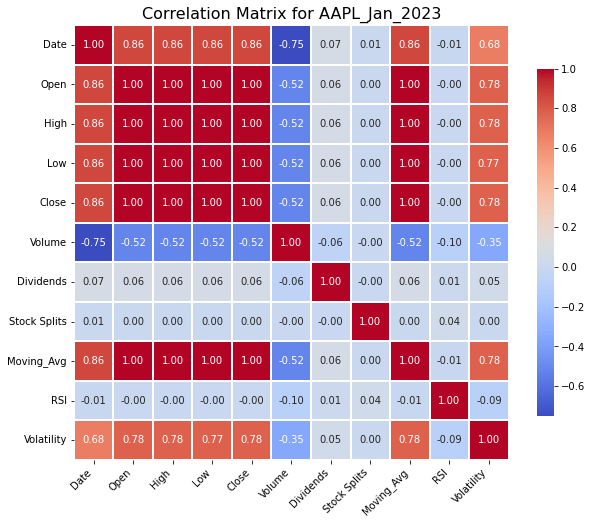

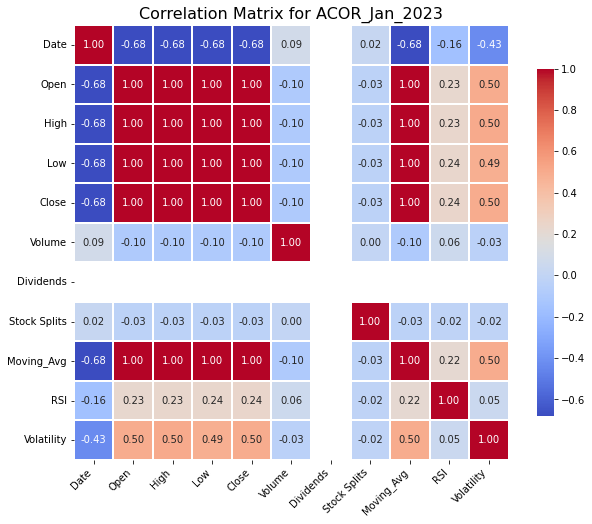

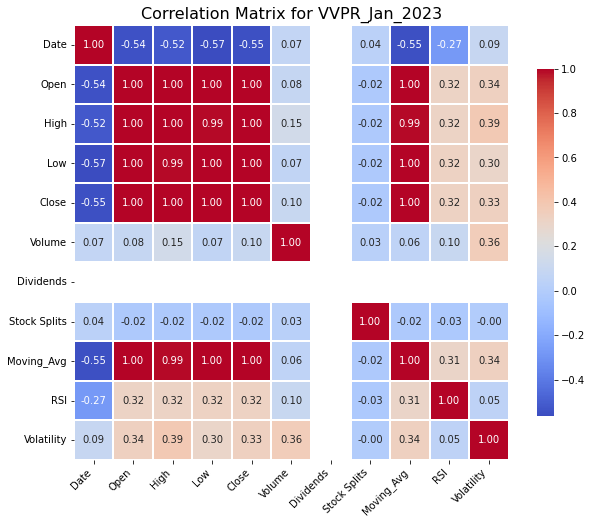

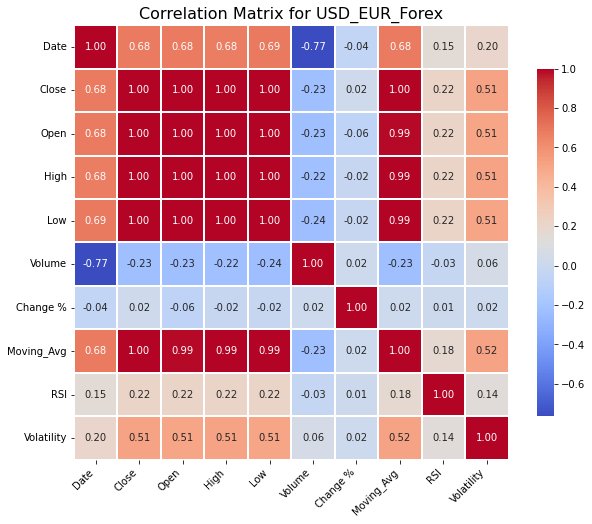

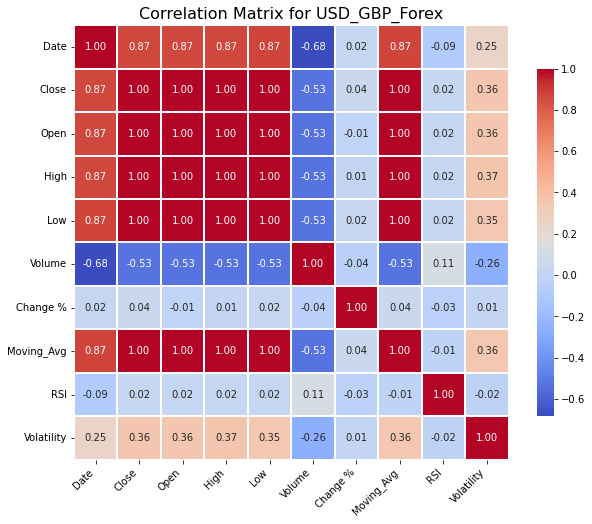

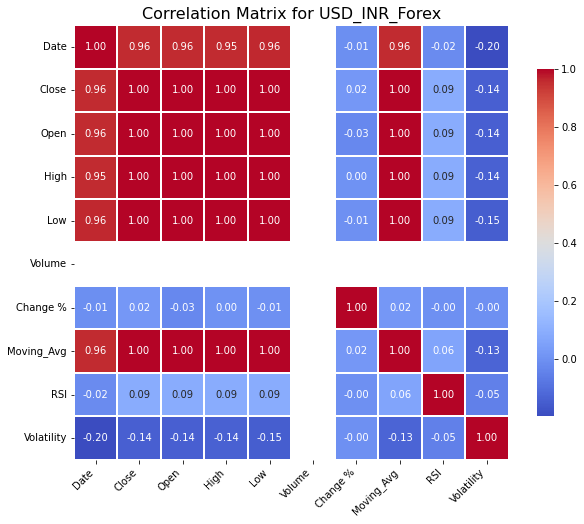

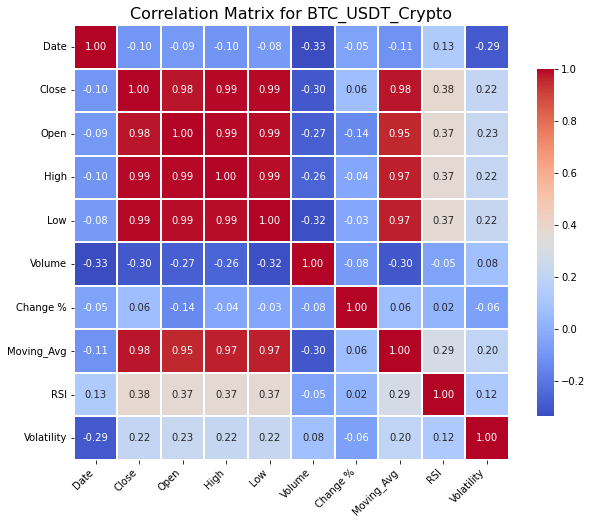

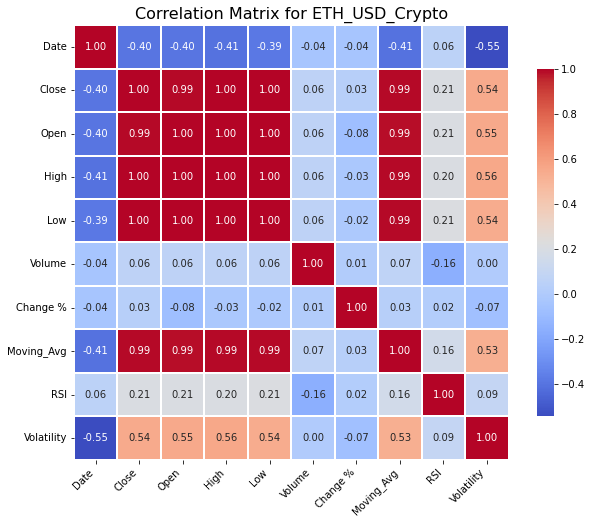

In [13]:
for name, df in datasets.items():
    plt.figure(figsize=(10, 8))  # Set the figure size for better readability
    plt.title(f"Correlation Matrix for {name}", fontsize=16)  # Add a title with increased font size
    
    # Generate the heatmap with additional visual enhancements
    sns.heatmap(
        df.corr(), 
        annot=True,  # Annotate each cell with the numeric value
        cmap='coolwarm',  # Use the coolwarm colormap
        fmt=".2f",  # Format the annotated value to 2 decimal places
        linewidths=.05,  # Add slight spacing between cells for clarity
        cbar_kws={'shrink': .8},  # Optionally shrink the color bar for a compact look
        square=True  # Make cells square for better aesthetics
    )
    
    plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better readability
    plt.yticks(rotation=0)  # Ensure y-axis labels are horizontal for consistency
    plt.show()


This heatmap (AAPL) represents the correlation coefficients between different stocks or financial instruments. Here are some key findings from this heatmap:

1. **High Positive Correlations (Red Zones)**: There are several areas with a correlation coefficient of 1, indicating that these stocks move in perfect unison. This could mean that the stocks belong to the same sector or are highly influenced by the same economic factors.

2. **High Negative Correlations (Blue Zones)**: There are pockets of negative correlations, most notably with a coefficient of -0.52. These negatively correlated stocks move in opposite directions and can be useful for diversification in a portfolio.

3. **Neutral to Low Correlations (White and Light Blue Zones)**: Many stocks show neutral to low correlation coefficients (ranging from 0 to 0.06). These stocks do not have a strong relationship and could provide beneficial diversification effects when combined in a portfolio.

4. **Consistent Negative Pairings**: The correlation of -0.52 appears frequently, suggesting a consistent negative relationship between certain stocks. This may be worth investigating to understand if there's a common cause affecting these stocks inversely.

5. **Diagonal Line of Perfect Correlation**: As expected, the diagonal from the top left to the bottom right shows a perfect correlation of 1, because it compares each stock to itself.

6. **No Perfect Anticorrelation**: There is no -1 correlation, which means there are no pairs of stocks that move in perfect opposite directions all the time.

7. **Potential Anomalies**: The areas where the correlation suddenly changes from 1 to -0.52 and then back to 1 could indicate data inconsistencies or anomalies that merit further investigation.

8. **Sparse High Correlation outside the Diagonal**: There are some isolated spots of high correlation outside the diagonal. These might indicate pairs or groups of stocks that are moving together due to shared factors or interdependencies.

Investors could use these findings to identify stocks for hedging (using negatively correlated pairs) or to create a balanced portfolio that maximizes returns while minimizing risk through diversification (mixing stocks with low or no correlation). The anomalies, if they represent true market phenomena, could signal opportunities for arbitrage. However, if the anomalies are data errors, they should be corrected to avoid skewing the analysis.

Analyzing the heatmap (USD/EUR Forex), here are some key findings:

1. **Predominant Positive Correlations**: The majority of the blocks show high positive correlations (values of 1 and close to 1), highlighted in red. These could represent stocks within the same sector or with shared drivers in their price movements.

2. **Clusters of High Correlation**: There are clusters of 1s and values very close to 1 (like 0.99), suggesting subgroups of stocks that are highly interrelated, possibly belonging to the same industry or affected similarly by market events.

3. **Moderate Negative Correlations**: A few stocks show moderate negative correlations, primarily in the range of -0.22 to -0.23, marked in blue. These stocks move in the opposite direction to some extent and can be potential candidates for hedging strategies.

4. **Anomalies or Data Issues**: The sharp contrasts between the highly positive correlations and the moderate negative ones could be indicative of anomalies or might represent data inconsistencies, which would need further verification.

5. **Isolated Correlation Values**: The presence of isolated high correlations (0.99) not on the diagonal may indicate a pair or group of stocks that are moving together. The reason behind this could be a shared factor such as market news or sector movements.

6. **Subtle Correlations and Diversification**: Some correlations are positive but less strong (e.g., 0.22), which indicates a mild positive relationship. These stocks could add diversity to a portfolio without being perfectly aligned with the movement of other assets.

7. **Divergent Stocks**: The values of -0.03, 0.01, and 0.02 are very close to zero, suggesting these stocks do not have a strong relationship with others in the set. They might represent different sectors or unique drivers that do not align with broader market trends.

8. **Diagonal Consistency**: The diagonal shows perfect correlations of 1, as each stock is perfectly correlated with itself.

These observations suggest a market with subsets of highly correlated stocks, potentially from the same sectors, along with a few that are moderately inversely related. The latter offers opportunities for risk diversification through hedging. However, the existence of moderate negative correlations amidst a field of strong positives warrants a closer look to ensure these are not artifacts or errors in the data.

## Data Integration:
For Unified Schema, we need to ensure all datasets have the same structure before we can combine them for analysis or comparison. This means having the same column names, formats, and types where applicable. To combine datasets from different financial instruments, consider the commonality - Date and Close price would be a good starting point.

In [14]:
def create_unified_schema(dfs, common_columns=['Date', 'Close']):
    # Ensure all dataframes have the same columns
    unified_dfs = []
    for df in dfs:
        if not isinstance(df, pd.DataFrame):
            raise ValueError("Each element in 'dfs' should be a pandas DataFrame.")
        unified_df = df[common_columns].copy() if set(common_columns).issubset(df.columns) else None
        if unified_df is not None:
            unified_dfs.append(unified_df)
        else:
            print(f"A dataframe is missing one of the required columns: {common_columns}")
    return unified_dfs

# Since 'datasets' is a dictionary where keys are dataset names and values are the dataframes
# We extract just the dataframes for the 'create_unified_schema' function
unified_dfs = create_unified_schema([datasets[name] for name in datasets])

# Now you can inspect the first few rows of the unified dataframes (if they were correctly unified)
for unified_df in unified_dfs:
    display(unified_df.head())

,Date,Close
4,2007-01-09 05:00:00+00:00,0.002223
5,2007-01-10 05:00:00+00:00,0.002908
6,2007-01-11 05:00:00+00:00,0.002722
7,2007-01-12 05:00:00+00:00,0.002540
8,2007-01-16 05:00:00+00:00,0.002923


,Date,Close
4,2007-01-09 05:00:00+00:00,0.356854
5,2007-01-10 05:00:00+00:00,0.362702
6,2007-01-11 05:00:00+00:00,0.362702
7,2007-01-12 05:00:00+00:00,0.380024
8,2007-01-16 05:00:00+00:00,0.393071


,Date,Close
4,2015-06-02 04:00:00+00:00,0.543580
5,2015-06-03 04:00:00+00:00,0.543580
6,2015-06-04 04:00:00+00:00,0.543015
7,2015-06-05 04:00:00+00:00,0.543015
8,2015-06-08 04:00:00+00:00,0.543015


,Date,Close
4,2023-12-25 00:00:00+00:00,0.420346
5,2023-12-22 00:00:00+00:00,0.419048
6,2023-12-21 00:00:00+00:00,0.419913
7,2023-12-20 00:00:00+00:00,0.445022
8,2023-12-19 00:00:00+00:00,0.429870


,Date,Close
4,2023-12-25 00:00:00+00:00,0.800019
5,2023-12-22 00:00:00+00:00,0.795573
6,2023-12-21 00:00:00+00:00,0.801952
7,2023-12-20 00:00:00+00:00,0.799439
8,2023-12-19 00:00:00+00:00,0.792867


,Date,Close
4,2023-12-25 00:00:00+00:00,0.976281
5,2023-12-22 00:00:00+00:00,0.976462
6,2023-12-21 00:00:00+00:00,0.980808
7,2023-12-20 00:00:00+00:00,0.974018
8,2023-12-19 00:00:00+00:00,0.971030


,Date,Close
4,2021-09-16 00:00:00+00:00,0.539092
5,2021-09-15 00:00:00+00:00,0.549933
6,2021-09-14 00:00:00+00:00,0.519329
7,2021-09-13 00:00:00+00:00,0.456605
8,2021-09-12 00:00:00+00:00,0.489381


,Date,Close
4,2023-12-27 00:00:00+00:00,0.404389
5,2023-12-26 00:00:00+00:00,0.368128
6,2023-12-25 00:00:00+00:00,0.378091
7,2023-12-24 00:00:00+00:00,0.376174
8,2023-12-23 00:00:00+00:00,0.387216


# Enhanced Descriptive Statistics

In order to gain a deeper understanding of the datasets' distribution, we enhance our descriptive statistics with measures of skewness and kurtosis. These statistical metrics provide insights into the symmetry and tail heaviness of the distribution of data, which are crucial aspects to consider in anomaly detection and financial data analysis.

## Skewness
Skewness measures the asymmetry of the probability distribution of a real-valued random variable about its mean. The skewness value can be positive, zero, negative, or undefined.

- **Positive Skew**: The right tail is longer; the mass of the distribution is concentrated on the left of the figure.
- **Negative Skew**: The left tail is longer; the mass of the distribution is concentrated on the right of the figure.
- **Zero Skew**: The values are relatively evenly distributed on both sides of the mean, typically (but not necessarily) implying a symmetric distribution.

## Kurtosis
Kurtosis is a measure of the "tailedness" of the probability distribution of a real-valued random variable. In other words, kurtosis identifies whether the tails of a given distribution contain extreme values.

- **High Kurtosis (>3)**: The distribution has heavier tails and a sharper peak than the normal distribution. It indicates a higher likelihood of extreme values, which is critical in financial datasets for spotting market crashes or booms.
- **Low Kurtosis (<3)**: The distribution has lighter tails and a flatter peak than the normal distribution. It suggests less extreme market movements and a more stable environment.
- **Kurtosis of 3**: This value indicates a normal distribution shape (mesokurtic).

By integrating these two metrics into our descriptive statistics, we aim to detect features with abnormal distribution shapes that might indicate potential anomalies or unusual market behavior.

## Implementation

We have defined a function `enhanced_descriptive_stats` that takes a dataframe as input and returns the descriptive statistics enhanced with the skewness and kurtosis values for each numerical feature. Below is the output of this function applied to our datasets:

In [15]:
from scipy.stats import skew, kurtosis

def enhanced_descriptive_stats(df):
    # Select only the numeric columns for skew and kurtosis
    numeric_df = df.select_dtypes(include=[np.number])
    description = numeric_df.describe()
    description.loc['skew'] = skew(numeric_df, nan_policy='omit')  # Use scipy's skew function
    description.loc['kurtosis'] = kurtosis(numeric_df, nan_policy='omit')  # Use scipy's kurtosis function
    return description

for name, df in datasets.items():
    print(f"Enhanced Descriptive Statistics for {name}:")
    print(df.head())
    display(enhanced_descriptive_stats(df))

Enhanced Descriptive Statistics for AAPL_Jan_2023:
                       Date      Open      High       Low     Close    Volume  \
4 2007-01-09 05:00:00+00:00  0.001093  0.001686  0.001081  0.002223  0.992932   
5 2007-01-10 05:00:00+00:00  0.002377  0.002426  0.002372  0.002908  0.874560   
6 2007-01-11 05:00:00+00:00  0.002561  0.002270  0.002629  0.002722  0.422884   
7 2007-01-12 05:00:00+00:00  0.002352  0.002006  0.002338  0.002540  0.384793   
8 2007-01-16 05:00:00+00:00  0.002521  0.002342  0.002683  0.002923  0.364305   

   Dividends  Stock Splits  Moving_Avg        RSI  Volatility  
4        0.0           0.0    0.001285  93.893680    0.000536  
5        0.0           0.0    0.001694  95.769616    0.000832  
6        0.0           0.0    0.002007  88.412210    0.000873  
7        0.0           0.0    0.002303  82.202334    0.000706  
8        0.0           0.0    0.002663  84.491650    0.000292  


,Open,High,Low,Close,Volume,Dividends,Stock Splits,Moving_Avg,RSI,Volatility
count,4274.000000,4274.000000,4274.000000,4274.000000,4274.000000,4274.000000,4274.000000,4274.000000,4274.000000,4274.000000
mean,0.235326,0.235782,0.234111,0.235534,0.099422,0.001813,0.002574,0.235079,56.183179,0.003771
std,0.279210,0.280147,0.277741,0.279307,0.110529,0.018043,0.123309,0.278833,17.871810,0.005382
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000652,3.179738,0.000040
25%,0.040793,0.040390,0.040522,0.040876,0.023522,0.000000,0.000000,0.040740,43.364547,0.000629
50%,0.113662,0.113648,0.112832,0.113338,0.053418,0.000000,0.000000,0.113470,56.445780,0.001408
75%,0.267766,0.267901,0.266358,0.266782,0.136989,0.000000,0.000000,0.265390,69.553161,0.004402
max,1.000000,1.000000,1.000000,1.000000,1.000000,0.240000,7.000000,0.995831,97.487746,0.043570
skew,1.317673,1.314764,1.320571,1.317517,2.179149,10.464930,50.744588,1.318049,-0.113459,2.521224
kurtosis,0.295118,0.279950,0.310627,0.294440,6.704068,112.726561,2682.918135,0.294543,-0.572528,7.659618


Enhanced Descriptive Statistics for ACOR_Jan_2023:
                       Date      Open      High       Low     Close    Volume  \
4 2007-01-09 05:00:00+00:00  0.352719  0.350220  0.356194  0.356854  0.000203   
5 2007-01-10 05:00:00+00:00  0.358391  0.361013  0.358714  0.362702  0.000349   
6 2007-01-11 05:00:00+00:00  0.364516  0.366300  0.366504  0.362702  0.000200   
7 2007-01-12 05:00:00+00:00  0.366558  0.373348  0.368337  0.380024  0.000250   
8 2007-01-16 05:00:00+00:00  0.384482  0.388987  0.384604  0.393071  0.000494   

   Dividends  Stock Splits  Moving_Avg        RSI  Volatility  
4        0.0           0.0    0.349520  68.292701    0.004771  
5        0.0           0.0    0.352040  75.925959    0.007628  
6        0.0           0.0    0.355729  75.925959    0.007379  
7        0.0           0.0    0.362433  85.945968    0.011161  
8        0.0           0.0    0.371071  89.300423    0.015053  


,Open,High,Low,Close,Volume,Dividends,Stock Splits,Moving_Avg,RSI,Volatility
count,4274.000000,4274.000000,4274.000000,4274.000000,4274.000000,4274.0,4274.000000,4274.000000,4274.000000,4274.000000
mean,0.441208,0.437168,0.435793,0.437120,0.002048,0.0,0.000051,0.437282,48.961816,0.011486
std,0.286317,0.283082,0.283511,0.283822,0.019646,0.0,0.002661,0.283272,17.785480,0.012318
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000037,2.696069,0.000013
25%,0.063053,0.063656,0.058920,0.061263,0.000459,0.0,0.000000,0.062826,35.956113,0.002938
50%,0.517545,0.511784,0.510501,0.512747,0.000702,0.0,0.000000,0.512972,49.252198,0.009033
75%,0.660535,0.651927,0.652608,0.653569,0.001205,0.0,0.000000,0.653873,61.844139,0.015735
max,1.000000,1.000000,1.000000,1.000000,1.000000,0.0,0.166667,0.982184,97.030765,0.133452
skew,-0.414282,-0.421502,-0.410050,-0.414903,36.809283,NaN,58.974411,-0.422235,-0.030443,2.929619
kurtosis,-1.115692,-1.113152,-1.122832,-1.117588,1664.061100,NaN,3621.615308,-1.114771,-0.517690,15.385013


Enhanced Descriptive Statistics for VVPR_Jan_2023:
                       Date      Open      High       Low     Close    Volume  \
4 2015-06-02 04:00:00+00:00  0.539171  0.397914  0.620106  0.543580  0.001318   
5 2015-06-03 04:00:00+00:00  0.540856  0.397914  0.622044  0.543580  0.000000   
6 2015-06-04 04:00:00+00:00  0.541418  0.398328  0.621398  0.543015  0.000049   
7 2015-06-05 04:00:00+00:00  0.540294  0.397501  0.621398  0.543015  0.000000   
8 2015-06-08 04:00:00+00:00  0.540294  0.397501  0.621398  0.543015  0.000000   

   Dividends  Stock Splits  Moving_Avg         RSI  Volatility  
4        0.0           0.0    0.541660  100.000000    0.001101  
5        0.0           0.0    0.542224  100.000000    0.001238  
6        0.0           0.0    0.542563   83.332486    0.001158  
7        0.0           0.0    0.542902   83.332486    0.000928  
8        0.0           0.0    0.543241   83.332486    0.000309  


,Open,High,Low,Close,Volume,Dividends,Stock Splits,Moving_Avg,RSI,Volatility
count,2135.000000,2135.000000,2135.000000,2135.000000,2135.000000,2135.0,2135.000000,2135.000000,2135.000000,2135.000000
mean,0.221625,0.167865,0.247839,0.222165,0.003472,0.0,0.000047,0.222671,47.862940,0.008149
std,0.210914,0.159233,0.237898,0.211412,0.026358,0.0,0.002164,0.210851,20.986507,0.017068
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000429,0.000000,0.000000
25%,0.054738,0.042043,0.060667,0.054962,0.000017,0.0,0.000000,0.055392,33.634443,0.001145
50%,0.123300,0.095506,0.136839,0.123877,0.000273,0.0,0.000000,0.124329,46.938764,0.002902
75%,0.404294,0.311636,0.442111,0.404592,0.001154,0.0,0.000000,0.407615,59.236946,0.007078
max,1.000000,1.000000,1.000000,1.000000,1.000000,0.0,0.100000,0.854827,100.000000,0.177408
skew,0.819389,0.874843,0.804288,0.811695,27.731866,NaN,46.173591,0.788042,0.452289,4.918847
kurtosis,-0.716970,-0.343018,-0.839404,-0.750839,977.639658,NaN,2130.000469,-0.844251,0.406605,30.718009


Enhanced Descriptive Statistics for USD_EUR_Forex:
                       Date     Close      Open      High       Low  Volume  \
4 2023-12-25 00:00:00+00:00  0.420346  0.417316  0.404456  0.434627     0.0   
5 2023-12-22 00:00:00+00:00  0.419048  0.419481  0.404456  0.427934     0.0   
6 2023-12-21 00:00:00+00:00  0.419913  0.444589  0.425450  0.438197     0.0   
7 2023-12-20 00:00:00+00:00  0.445022  0.430303  0.427164  0.448461     0.0   
8 2023-12-19 00:00:00+00:00  0.429870  0.450649  0.432305  0.447568     0.0   

   Change %  Moving_Avg        RSI  Volatility  
4    0.0003    0.405368  58.088235    0.012675  
5   -0.0002    0.407013  56.834532    0.014022  
6   -0.0063    0.410649  57.446809    0.014654  
7    0.0038    0.422424  69.849246    0.013663  
8   -0.0052    0.426840  59.401709    0.011075  


,Close,Open,High,Low,Volume,Change %,Moving_Avg,RSI,Volatility
count,777.000000,777.000000,777.000000,777.000000,777.000000,777.000000,777.000000,777.000000,777.000000
mean,0.415911,0.415241,0.408883,0.419392,0.297783,0.000146,0.416875,47.734321,0.016902
std,0.232806,0.233353,0.235173,0.235142,0.222784,0.004938,0.231281,15.925263,0.010397
min,0.000000,0.000000,0.000000,0.000000,0.000000,-0.021000,0.015411,11.931818,0.001688
25%,0.203463,0.195671,0.194087,0.203481,0.000000,-0.002700,0.211082,35.348837,0.009682
50%,0.450216,0.445887,0.439589,0.452477,0.352412,0.000100,0.446494,47.786260,0.013932
75%,0.565801,0.565801,0.558269,0.568942,0.455106,0.003000,0.566234,59.696459,0.021178
max,1.000000,1.000000,1.000000,1.000000,1.000000,0.015100,0.956017,90.070922,0.063677
skew,0.120643,0.122960,0.142681,0.102084,-0.121953,-0.164038,0.111533,0.081549,1.525355
kurtosis,-0.691728,-0.695562,-0.675455,-0.705275,-0.960918,1.062240,-0.704689,-0.736958,2.750459


Enhanced Descriptive Statistics for USD_GBP_Forex:
                       Date     Close      Open      High       Low  Volume  \
4 2023-12-25 00:00:00+00:00  0.800019  0.798706  0.795417  0.802000     0.0   
5 2023-12-22 00:00:00+00:00  0.795573  0.807495  0.807116  0.795688     0.0   
6 2023-12-21 00:00:00+00:00  0.801952  0.803632  0.805666  0.809963     0.0   
7 2023-12-20 00:00:00+00:00  0.799439  0.790206  0.798028  0.796854     0.0   
8 2023-12-19 00:00:00+00:00  0.792867  0.800831  0.803635  0.800932     0.0   

   Change %  Moving_Avg        RSI  Volatility  
4    0.0006    0.789407  86.476190    0.020063  
5   -0.0009    0.795921  79.509632    0.013589  
6    0.0004    0.801740  81.632653    0.004298  
7    0.0010    0.800773  78.431373    0.004126  
8   -0.0007    0.797970  71.135431    0.003674  


,Close,Open,High,Low,Volume,Change %,Moving_Avg,RSI,Volatility
count,772.000000,772.000000,772.000000,772.000000,772.000000,772.000000,772.000000,772.000000,772.000000
mean,0.424286,0.425605,0.428400,0.419964,0.072142,0.000120,0.425901,47.863009,0.015328
std,0.317949,0.317766,0.320484,0.317752,0.124236,0.002964,0.317756,18.220319,0.012284
min,0.000000,0.000000,0.000000,0.000000,0.000000,-0.016100,0.006843,5.216928,0.000000
25%,0.142181,0.144065,0.143189,0.138619,0.000000,-0.001200,0.142843,34.731419,0.006708
50%,0.394694,0.393171,0.403945,0.380559,0.000000,0.000100,0.395853,48.406559,0.011481
75%,0.739320,0.735705,0.743160,0.724995,0.127885,0.001500,0.754311,60.146029,0.020859
max,1.000000,1.000000,1.000000,1.000000,1.000000,0.010000,0.973884,94.021102,0.078611
skew,0.331444,0.334124,0.322224,0.342208,2.251595,-0.515467,0.317772,0.056206,1.658346
kurtosis,-1.364478,-1.365690,-1.376681,-1.355851,7.128534,3.300984,-1.381214,-0.363995,3.581310


Enhanced Descriptive Statistics for USD_INR_Forex:
                       Date     Close      Open      High       Low  Volume  \
4 2023-12-25 00:00:00+00:00  0.976281  0.977275  0.970972  0.978341     0.0   
5 2023-12-22 00:00:00+00:00  0.976462  0.981062  0.979681  0.977710     0.0   
6 2023-12-21 00:00:00+00:00  0.980808  0.976102  0.981132  0.982583     0.0   
7 2023-12-20 00:00:00+00:00  0.974018  0.971143  0.976234  0.976356     0.0   
8 2023-12-19 00:00:00+00:00  0.971030  0.974930  0.975417  0.974822     0.0   

   Change %  Moving_Avg        RSI  Volatility  
4    0.0000    0.978526  44.247788    0.003910  
5   -0.0006    0.978092  44.736842    0.004015  
6    0.0009    0.978906  54.347826    0.004083  
7    0.0004    0.976661  42.735043    0.002511  
8   -0.0005    0.975720  39.062500    0.003593  


,Close,Open,High,Low,Volume,Change %,Moving_Avg,RSI,Volatility
count,777.000000,777.000000,777.000000,777.000000,777.0,777.000000,777.000000,777.000000,777.000000
mean,0.539642,0.539976,0.546647,0.534681,0.0,0.000171,0.541991,46.508111,0.016323
std,0.353622,0.352500,0.353962,0.353664,0.0,0.002814,0.353055,17.531134,0.011286
min,0.000000,0.000000,0.000000,0.000000,0.0,-0.009200,0.008456,7.006961,0.000972
25%,0.190748,0.190730,0.192761,0.184821,0.0,-0.001200,0.189317,33.204447,0.008448
50%,0.593790,0.565335,0.596154,0.556809,0.0,0.000100,0.601177,46.968326,0.013691
75%,0.895618,0.895843,0.907656,0.894324,0.0,0.001400,0.900851,58.634538,0.021650
max,1.000000,1.000000,1.000000,1.000000,0.0,0.016400,0.995184,91.264668,0.074939
skew,-0.072701,-0.068139,-0.079292,-0.062740,NaN,0.657994,-0.081069,0.110819,1.499680
kurtosis,-1.676133,-1.676121,-1.678673,-1.676110,NaN,3.789573,-1.681356,-0.570453,2.941425


Enhanced Descriptive Statistics for BTC_USDT_Crypto:
                       Date     Close      Open      High       Low    Volume  \
4 2021-09-16 00:00:00+00:00  0.539092  0.554580  0.544497  0.538751  0.063492   
5 2021-09-15 00:00:00+00:00  0.549933  0.524292  0.542924  0.529813  0.047619   
6 2021-09-14 00:00:00+00:00  0.519329  0.462215  0.508744  0.468667  0.063492   
7 2021-09-13 00:00:00+00:00  0.456605  0.494285  0.497916  0.430937  0.174603   
8 2021-09-12 00:00:00+00:00  0.489381  0.468598  0.485688  0.470557  0.031746   

   Change %  Moving_Avg        RSI  Volatility  
4   -0.0077    0.513343  82.959409    0.051608  
5    0.0222    0.538569  83.954096    0.014086  
6    0.0477    0.537661  72.077685    0.015358  
7   -0.0243    0.518007  55.876744    0.036352  
8    0.0199    0.510868  60.514374    0.038080  


,Close,Open,High,Low,Volume,Change %,Moving_Avg,RSI,Volatility
count,259.000000,259.000000,259.000000,259.000000,259.000000,259.000000,259.000000,259.000000,259.000000
mean,0.446141,0.450117,0.466206,0.426651,0.151437,0.002937,0.449762,48.212757,0.049559
std,0.271695,0.270047,0.266104,0.275955,0.156519,0.045066,0.265009,16.053359,0.023848
min,0.000000,0.000000,0.000000,0.000000,0.000000,-0.144900,0.051003,13.419679,0.010092
25%,0.187629,0.193872,0.226434,0.167279,0.063492,-0.021450,0.205364,36.307079,0.032057
50%,0.463055,0.468488,0.493504,0.454427,0.095238,0.000500,0.483977,50.124310,0.047115
75%,0.668091,0.671944,0.705471,0.652017,0.190476,0.027000,0.680555,58.919560,0.060552
max,1.000000,1.000000,1.000000,1.000000,1.000000,0.193800,0.961990,87.223047,0.123169
skew,0.182341,0.184485,0.152155,0.209490,2.672353,0.186680,0.163249,-0.123821,0.842574
kurtosis,-1.274508,-1.274428,-1.299452,-1.264403,9.031699,1.547756,-1.330468,-0.529937,0.506764


Enhanced Descriptive Statistics for ETH_USD_Crypto:
                       Date     Close      Open      High       Low    Volume  \
4 2023-12-27 00:00:00+00:00  0.404389  0.368788  0.400545  0.372555  0.000298   
5 2023-12-26 00:00:00+00:00  0.368128  0.378419  0.372233  0.365284  0.000224   
6 2023-12-25 00:00:00+00:00  0.378091  0.376368  0.379154  0.382460  0.000155   
7 2023-12-24 00:00:00+00:00  0.376174  0.387893  0.384466  0.381073  0.000167   
8 2023-12-23 00:00:00+00:00  0.387216  0.391780  0.385637  0.385999  0.000138   

   Change %  Moving_Avg         RSI  Volatility  
4    0.0663    0.389807  100.000000    0.010047  
5   -0.0179    0.387299   39.547145    0.013773  
6    0.0035    0.386303   48.158144    0.014324  
7   -0.0195    0.384555   46.873401    0.015051  
8   -0.0067    0.382799   53.949197    0.013847  


,Close,Open,High,Low,Volume,Change %,Moving_Avg,RSI,Volatility
count,1088.000000,1088.000000,1088.000000,1088.000000,1088.000000,1088.000000,1088.000000,1088.000000,1088.000000
mean,0.357698,0.357757,0.365217,0.350366,0.009670,0.002086,0.358370,48.059384,0.018937
std,0.212156,0.212643,0.216400,0.209073,0.083168,0.044877,0.210508,16.914328,0.015940
min,0.000000,0.000000,0.000000,0.000000,0.000000,-0.278600,0.047995,2.905845,0.000619
25%,0.215324,0.215432,0.219771,0.209497,0.000100,-0.018325,0.215114,35.363400,0.007605
50%,0.279726,0.279935,0.282288,0.279963,0.000203,0.001000,0.280214,48.917028,0.014701
75%,0.484682,0.484945,0.493029,0.466869,0.000315,0.022550,0.482549,60.580683,0.025120
max,1.000000,1.000000,1.000000,1.000000,1.000000,0.264600,0.976444,100.000000,0.119098
skew,1.048023,1.045242,1.040262,1.037867,9.243320,0.161456,1.045285,-0.143875,1.869339
kurtosis,0.251852,0.249986,0.193480,0.283367,87.190556,5.284791,0.217894,-0.435000,5.250014


# Interactive Visualization with Subplots

In the complex and dynamic world of financial markets, the ability to visualize and interact with time series data is invaluable. To this end, we utilize the power of Plotly's interactive plotting capabilities to create composite visualizations that allow us to observe not just the price action but also the trading volume, which can be an indicator of market sentiment.

## Subplot Composition

The `plot_with_subplots` function is designed to generate a two-row subplot for each financial dataset:

- **Top Subplot - Close Price**: The first subplot showcases the time series of normalized close prices. It provides a clear visualization of the price trend over time, allowing for the analysis of patterns, trends, and potential anomalies in the price movements.

- **Bottom Subplot - Volume**: The second subplot displays the trading volume as a bar chart, which can highlight spikes in trading activity. Volume spikes often correspond to key market events or significant trader reactions, and thus, serve as a critical component of our analysis.

## Enhanced Interaction

By leveraging Plotly's interactive features, these charts enable users to:

- Zoom in on specific time periods to get a more detailed view.
- Pan across the timeline to analyze different intervals.
- Hover over specific points to see detailed information about price and volume at particular moments in time.

## Customization

To further enhance the utility and readability of the charts, the following customizations are included:

- **Shared X-Axis**: Both subplots share the same x-axis, ensuring that the time alignment between price and volume is maintained regardless of user interaction.
- **Subplot Titles**: Each subplot is clearly titled to delineate the different aspects of the data being analyzed.
- **Sizing**: The figure size is set to provide a balance between detail and layout, ensuring the charts are large enough to be informative but compact enough to fit within the screen.

## Implementation

The function is applied to each dataset in our collection, generating an interactive figure for each. The figures are rendered directly within the Jupyter notebook, providing immediate access to enhanced visual analysis.


In [16]:
from plotly.subplots import make_subplots

def plot_with_subplots(df, title):
    # Ensure 'Date' is a list of python datetime objects
    dates = np.array(df['Date'].dt.to_pydatetime())

    # Create subplots: one for close prices, one for volume
    fig = make_subplots(rows=2, cols=1, shared_xaxes=True, 
                        subplot_titles=('Close Price', 'Volume'), 
                        vertical_spacing=0.1)

    # Close price plot
    fig.add_trace(go.Scatter(x=dates, y=df['Close'], name='Close'), row=1, col=1)

    # Volume plot
    if 'Volume' in df.columns:
        fig.add_trace(go.Bar(x=dates, y=df['Volume'], name='Volume'), row=2, col=1)

    fig.update_layout(height=600, width=800, title_text=title)
    fig.show()

# Example usage
for name, df in datasets.items():
    plot_with_subplots(df, f"Visualization for {name}")


/var/folders/10/h7s5r7412qx71dtcn7qt4_ym0000gn/T/ipykernel_83979/1972570654.py:5: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



Box Plots for AAPL_Jan_2023


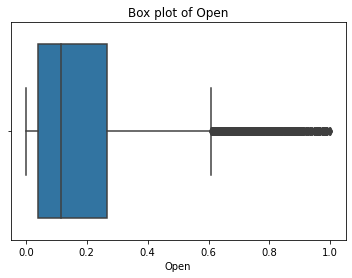

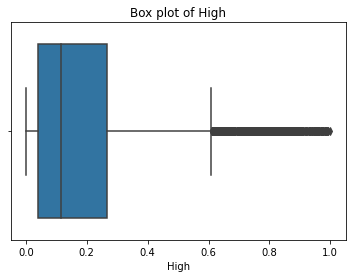

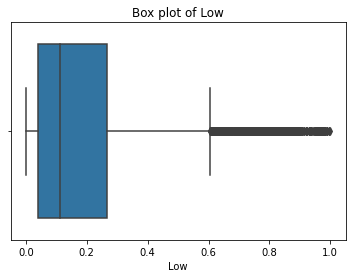

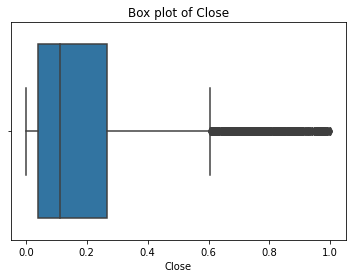

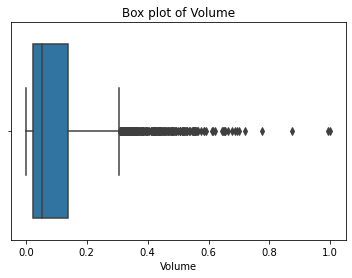

Box Plots for ACOR_Jan_2023


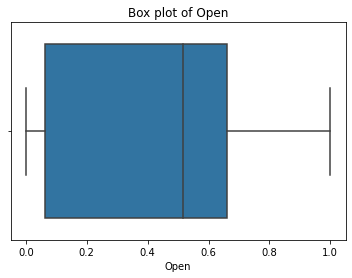

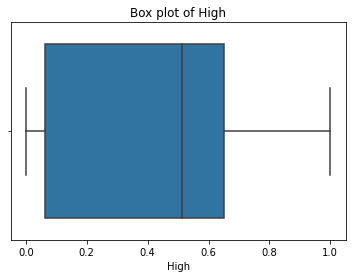

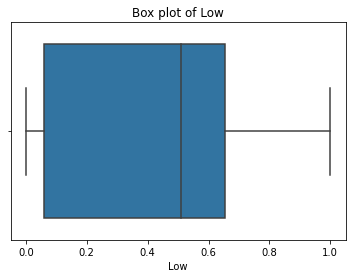

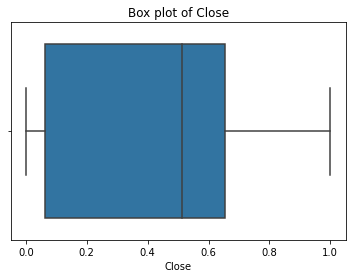

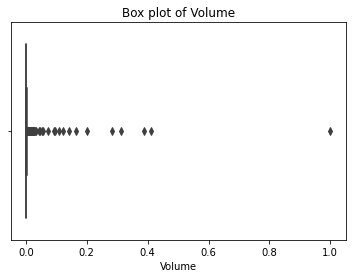

Box Plots for VVPR_Jan_2023


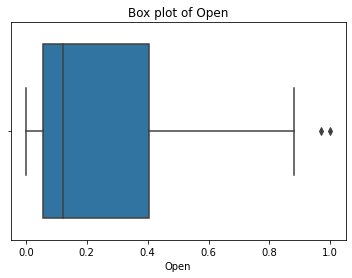

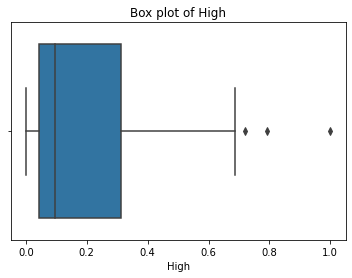

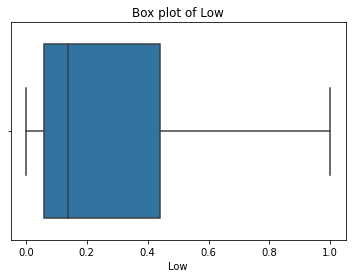

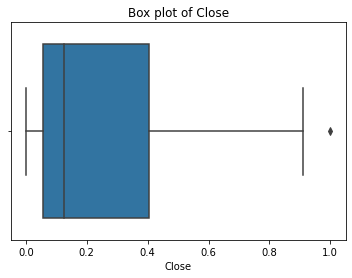

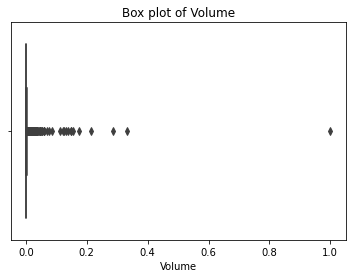

Box Plots for USD_EUR_Forex


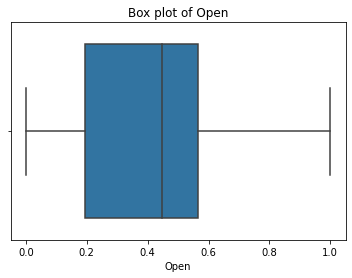

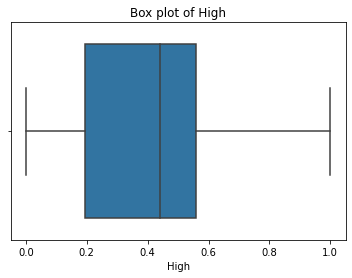

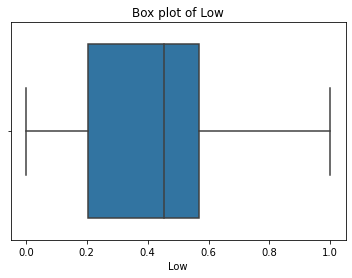

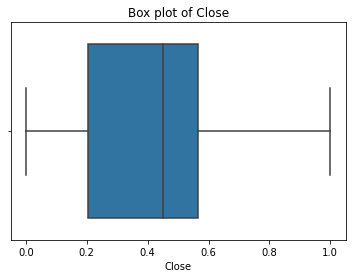

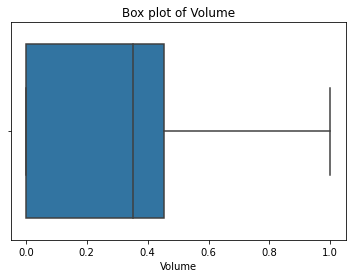

Box Plots for USD_GBP_Forex


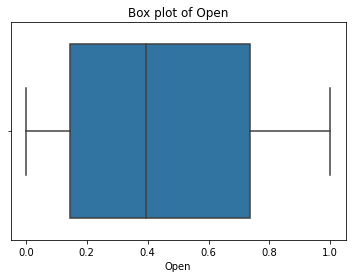

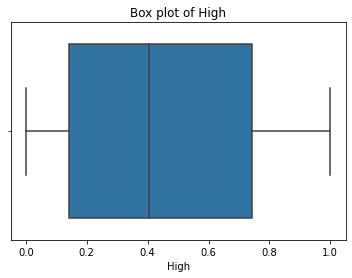

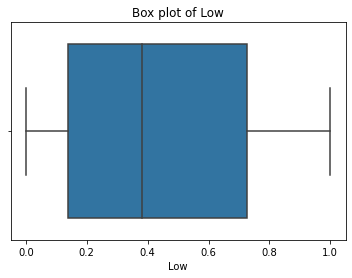

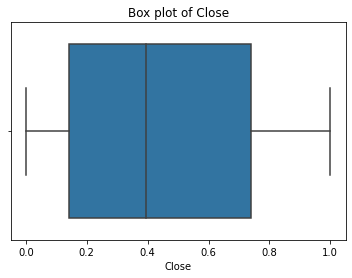

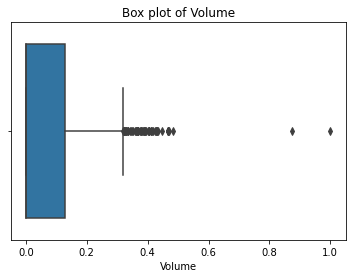

Box Plots for USD_INR_Forex


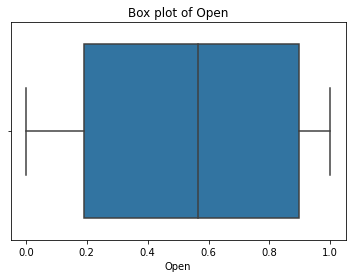

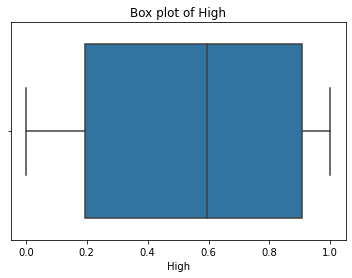

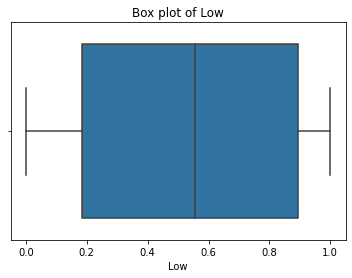

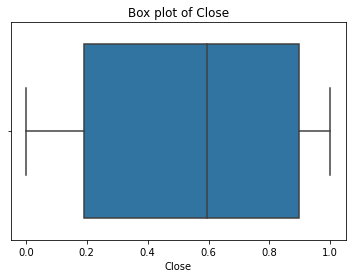

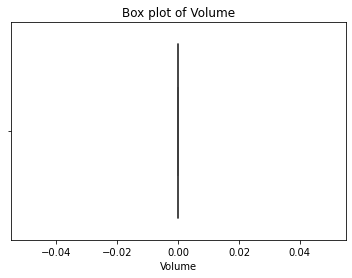

Box Plots for BTC_USDT_Crypto


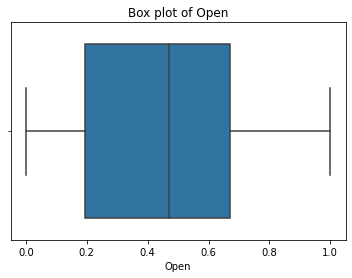

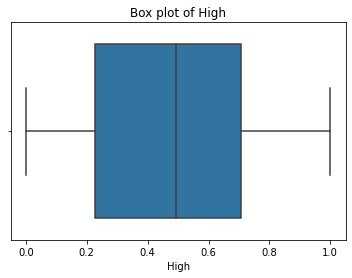

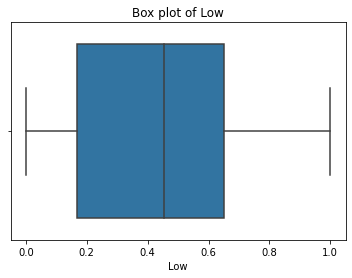

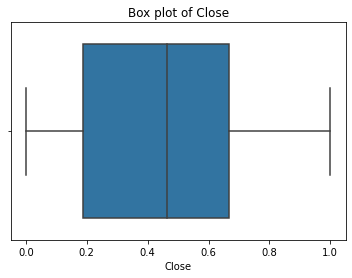

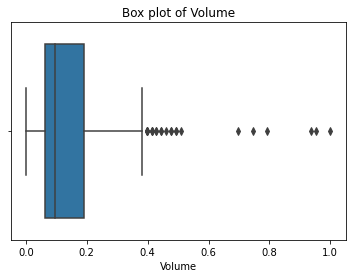

Box Plots for ETH_USD_Crypto


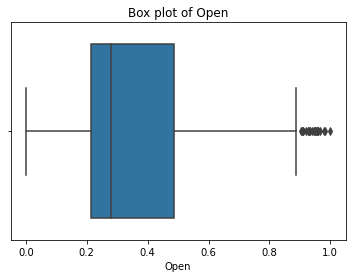

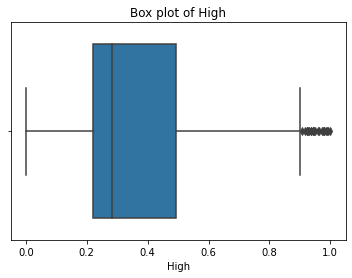

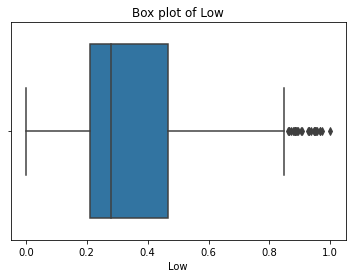

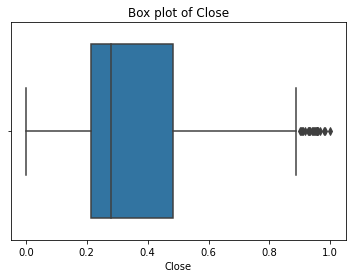

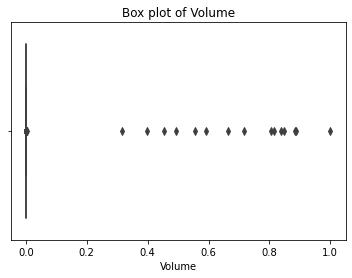

In [17]:
def plot_box_plots(df):
    # Plot box plots for key columns to visualize outliers
    cols_to_plot = ['Open', 'High', 'Low', 'Close', 'Volume']
    for col in cols_to_plot:
        if col in df.columns:
            sns.boxplot(x=df[col])
            plt.title(f'Box plot of {col}')
            plt.show()

for name, df in datasets.items():
    print(f"Box Plots for {name}")
    plot_box_plots(df)

In [18]:
def plot_candlestick(df, title):
    fig = go.Figure(data=[go.Candlestick(x=df['Date'],
                open=df['Open'], high=df['High'],
                low=df['Low'], close=df['Close'])])
    fig.update_layout(title=title, xaxis_rangeslider_visible=False)
    fig.show()

# Example usage for one dataset
plot_candlestick(datasets['AAPL_Jan_2023'], 'AAPL Jan 2023')

/Users/nikhilbindal/opt/anaconda3/lib/python3.9/site-packages/_plotly_utils/basevalidators.py:107: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



Histograms for AAPL_Jan_2023


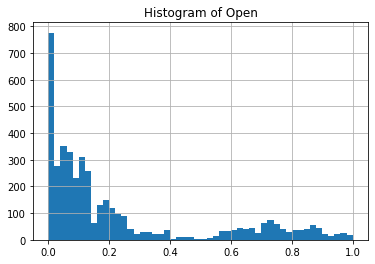

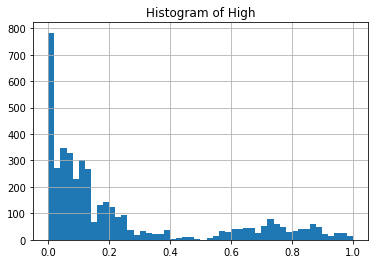

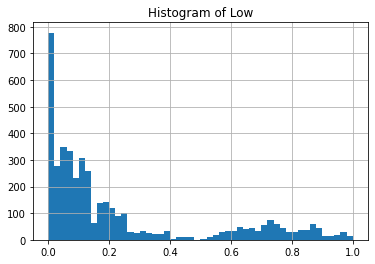

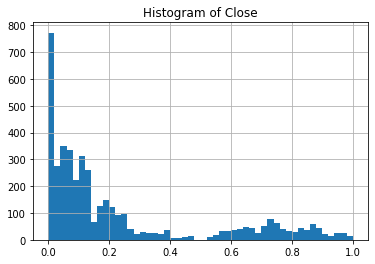

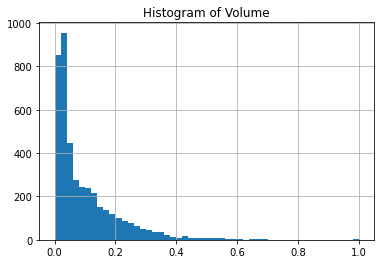

Histograms for ACOR_Jan_2023


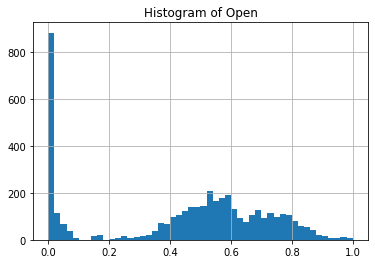

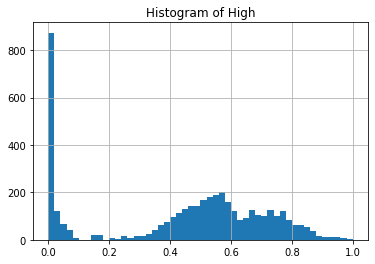

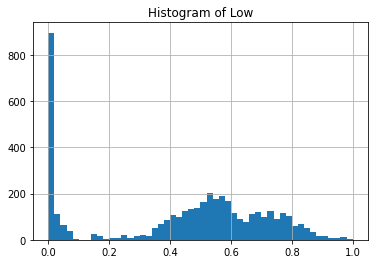

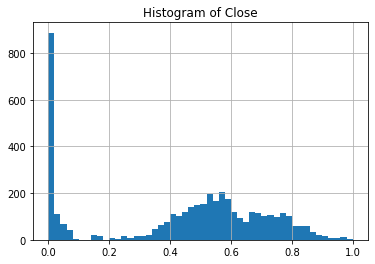

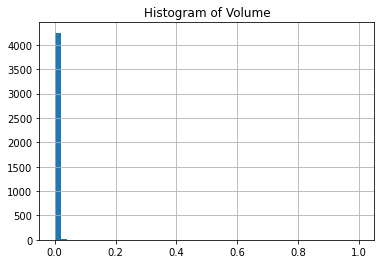

Histograms for VVPR_Jan_2023


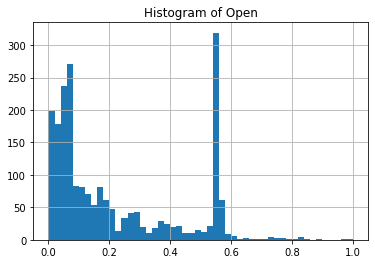

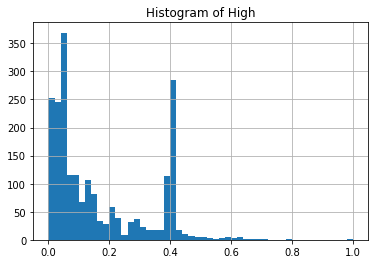

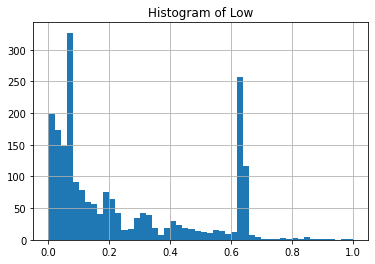

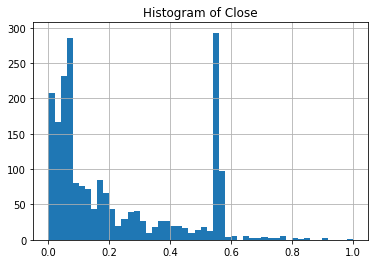

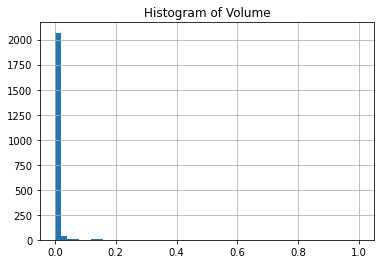

Histograms for USD_EUR_Forex


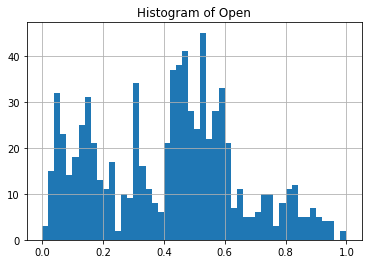

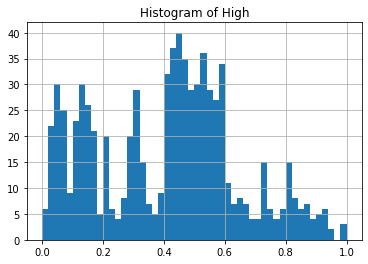

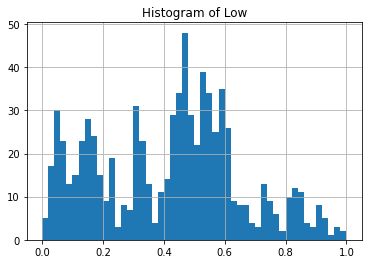

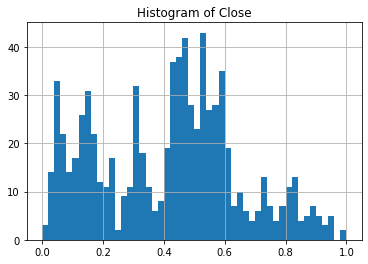

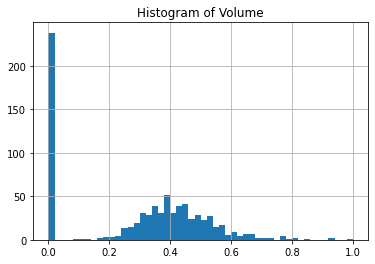

Histograms for USD_GBP_Forex


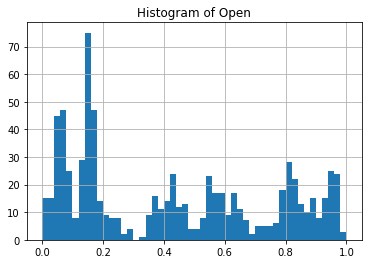

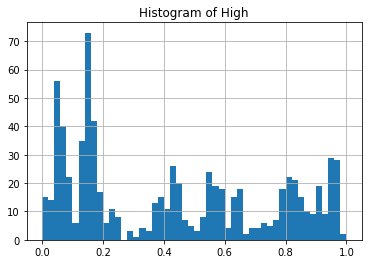

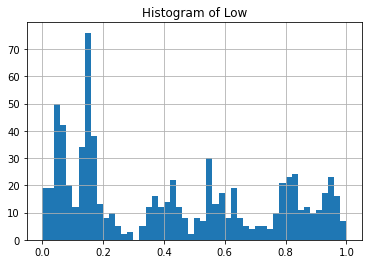

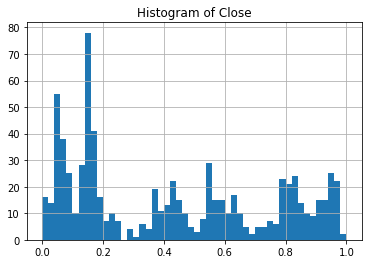

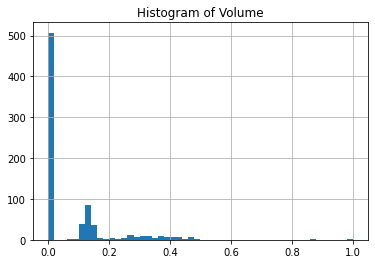

Histograms for USD_INR_Forex


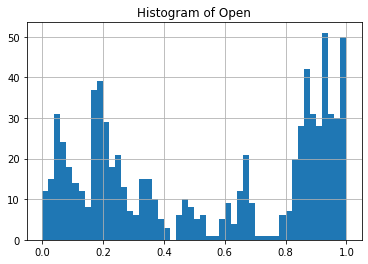

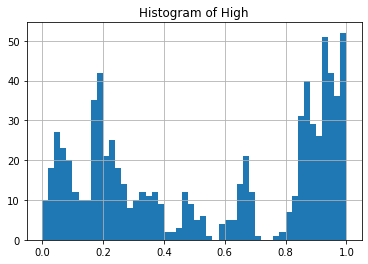

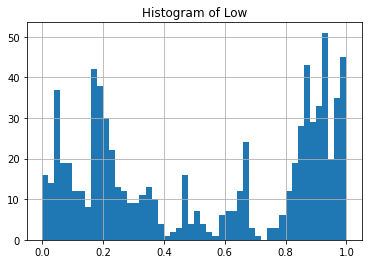

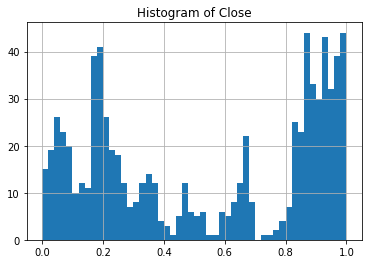

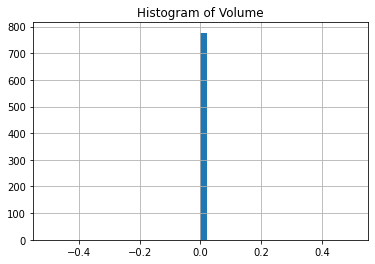

Histograms for BTC_USDT_Crypto


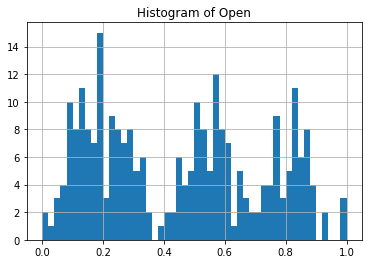

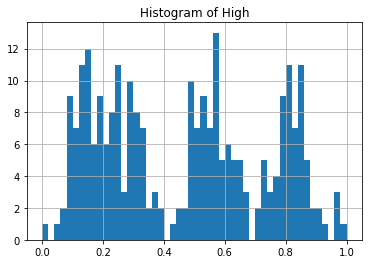

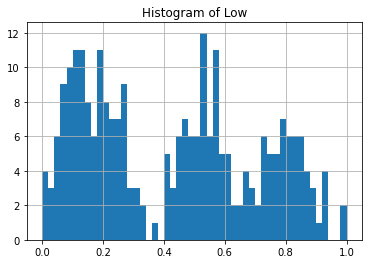

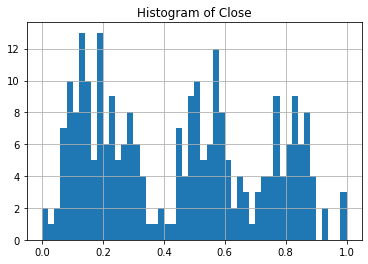

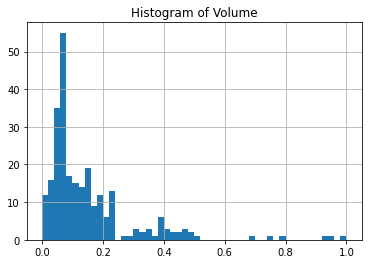

Histograms for ETH_USD_Crypto


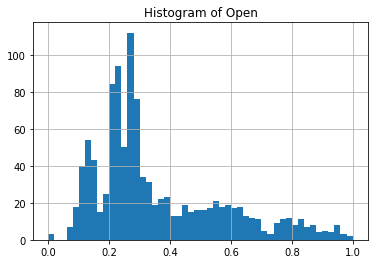

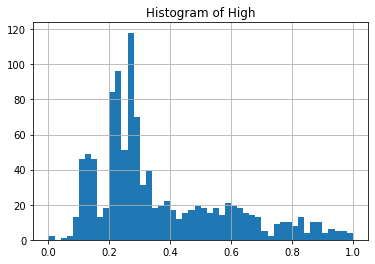

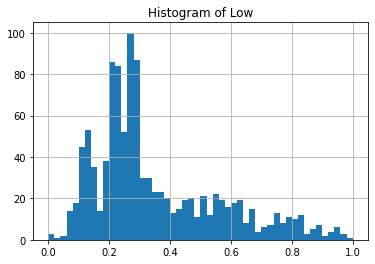

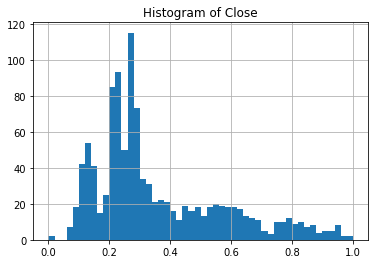

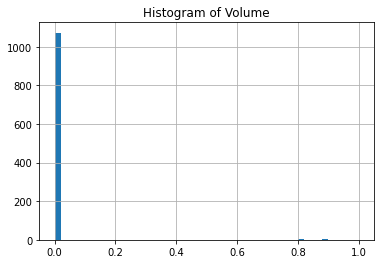

In [19]:
def plot_histograms(df):
    # Plot histograms for key columns
    cols_to_plot = ['Open', 'High', 'Low', 'Close', 'Volume']
    for col in cols_to_plot:
        if col in df.columns:
            df[col].hist(bins=50)
            plt.title(f'Histogram of {col}')
            plt.show()

# Example usage
for name, df in datasets.items():
    print(f"Histograms for {name}")
    plot_histograms(df)


### Technical Analysis Indicators:
Bollinger Bands: These can be added to price plots to show volatility and potential price breakouts.

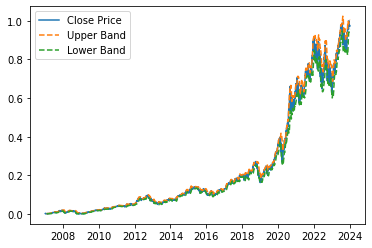

In [20]:
def add_bollinger_bands(df):
    df['Middle Band'] = df['Close'].rolling(window=20).mean()
    df['Upper Band'] = df['Middle Band'] + 1.96*df['Close'].rolling(window=20).std()
    df['Lower Band'] = df['Middle Band'] - 1.96*df['Close'].rolling(window=20).std()
    return df

# Add Bollinger Bands and plot for a dataset
df_with_bbands = add_bollinger_bands(datasets['AAPL_Jan_2023'])
plt.plot(df_with_bbands['Date'], df_with_bbands['Close'], label='Close Price')
plt.plot(df_with_bbands['Date'], df_with_bbands['Upper Band'], label='Upper Band', linestyle='--')
plt.plot(df_with_bbands['Date'], df_with_bbands['Lower Band'], label='Lower Band', linestyle='--')
plt.legend()
plt.show()


MACD (Moving Average Convergence Divergence): This indicator can help identify trend reversals and momentum.

In [21]:
# MACD

Comparative Analysis: Compare the performance of different stocks, currencies, or cryptocurrencies within the same timeframe to identify outliers or anomalies.

In [22]:
### Compare all the datasets for timeframe 2022-2023

### Anomaly Detection
Introduce basic anomaly detection based on thresholds or deviations. This section will be more exploratory and can expand based on specific research questions or hypotheses.

In [23]:
def detect_anomalies(df):
    # Example: Extreme RSI values might indicate anomalies
    anomalies = df[(df['RSI'] > 70) | (df['RSI'] < 30)]
    return anomalies

for name, df in datasets.items():
    anomalies = detect_anomalies(df)
    print(f"Anomalies detected in {name}:")
    print(anomalies)

Anomalies detected in AAPL_Jan_2023:
                          Date      Open      High       Low     Close  \
4    2007-01-09 05:00:00+00:00  0.001093  0.001686  0.001081  0.002223   
5    2007-01-10 05:00:00+00:00  0.002377  0.002426  0.002372  0.002908   
6    2007-01-11 05:00:00+00:00  0.002561  0.002270  0.002629  0.002722   
7    2007-01-12 05:00:00+00:00  0.002352  0.002006  0.002338  0.002540   
8    2007-01-16 05:00:00+00:00  0.002521  0.002342  0.002683  0.002923   
...                        ...       ...       ...       ...       ...   
4252 2023-11-22 05:00:00+00:00  0.966618  0.966064  0.968299  0.965260   
4253 2023-11-24 05:00:00+00:00  0.963449  0.955767  0.960181  0.958415   
4254 2023-11-27 05:00:00+00:00  0.958592  0.954600  0.958383  0.957495   
4255 2023-11-28 05:00:00+00:00  0.957877  0.956680  0.960952  0.960611   
4257 2023-11-30 05:00:00+00:00  0.958183  0.952825  0.954735  0.958313   

        Volume  Dividends  Stock Splits  Moving_Avg        RSI  Volatility

                         Date     Close      Open      High       Low  \
4   2021-09-16 00:00:00+00:00  0.539092  0.554580  0.544497  0.538751   
5   2021-09-15 00:00:00+00:00  0.549933  0.524292  0.542924  0.529813   
6   2021-09-14 00:00:00+00:00  0.519329  0.462215  0.508744  0.468667   
14  2021-09-06 00:00:00+00:00  0.682429  0.659911  0.666102  0.656861   
50  2021-08-01 00:00:00+00:00  0.308203  0.359418  0.376157  0.312809   
56  2021-07-26 00:00:00+00:00  0.232394  0.185630  0.319528  0.186361   
57  2021-07-25 00:00:00+00:00  0.177134  0.166650  0.172036  0.146466   
58  2021-07-24 00:00:00+00:00  0.131166  0.133975  0.132906  0.132411   
59  2021-07-23 00:00:00+00:00  0.123017  0.096465  0.121037  0.090651   
60  2021-07-22 00:00:00+00:00  0.087039  0.091783  0.092373  0.082463   
61  2021-07-21 00:00:00+00:00  0.081972  0.024035  0.097332  0.015220   
62  2021-07-20 00:00:00+00:00  0.013853  0.053998  0.048592  0.008330   
63  2021-07-19 00:00:00+00:00  0.044129  0.081071  

# Anomaly Detection with ARIMA

Autoregressive Integrated Moving Average (ARIMA) models are commonly used in time-series analysis to predict future points. However, they can also be used for anomaly detection.

## ARIMA Model
ARIMA model attempts to describe the movements in a stationary time series as a function of past values and stochastic errors.

## Limitations of ARIMA
- Assumes time series is stationary.
- Not suitable for high-frequency trading data.
- Difficult to model when there are sudden structural changes.

In [24]:
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.stattools import adfuller

# Function to test stationarity
def test_stationarity(timeseries):
    dftest = adfuller(timeseries.dropna(), autolag='AIC')  # Ensure timeseries doesn't have NaNs
    return pd.Series(dftest[0:4], index=['Test Statistic', 'p-value', '#Lags Used', 'Number of Observations Used'])

In [25]:
def plot_anomalies(df, title, col):
    # Trace for the time series data
    trace1 = go.Scatter(
        x=df.index,
        y=df['Close'],
        mode='lines',
        name='Actual'
    )

    # Trace for the forecasted data
    trace2 = go.Scatter(
        x=df.index,
        y=df['Forecast'],
        mode='lines',
        name='Forecast'
    )

    # Trace for anomalies
    anomalies = df[df[col]]
    trace3 = go.Scatter(
        x=anomalies.index,
        y=anomalies['Close'],
        mode='markers',
        name='Anomaly',
        marker=dict(
            color='red',
            size=11,
            line=dict(
                color='red',
                width=2
            )
        )
    )

    layout = go.Layout(
        title=title,
        xaxis=dict(title='Date'),
        yaxis=dict(title='Value')
    )

    data = [trace1, trace2, trace3]

    fig = go.Figure(data=data, layout=layout)
    fig.show()


In [26]:
def detect_anomalies_arima(df, column_name='Close'):
    # Create a copy of the DataFrame to avoid SettingWithCopyWarning
    df_copy = df.copy()

    # Handle missing or infinite values
    df_copy[column_name] = df_copy[column_name].replace([np.inf, -np.inf], np.nan)
    df_copy[column_name] = df_copy[column_name].ffill()  # Forward fill
    df_copy[column_name] = df_copy[column_name].bfill()  # Backward fill if needed
    
    # Set the frequency for the DatetimeIndex
    df_copy.set_index('Date', inplace=True)  # Set 'Date' as index
    df_copy = df_copy.asfreq('D', method='ffill')

    # Test stationarity
    stationary = test_stationarity(df_copy[column_name])
    if stationary['p-value'] > 0.05:
        # Data is not stationary, needs differencing
        #df_copy['Differenced'] = df_copy[column_name].diff().fillna(method='bfill')
        df_copy['Differenced'] = df_copy[column_name].diff().bfill()

    # Fit ARIMA model (assuming stationary data)
    model = ARIMA(df_copy['Differenced'].dropna(), order=(5,1,0))
    model_fit = model.fit()

    # Predictions and anomalies
    df_copy['Forecast'] = model_fit.predict(start=1, end=len(df_copy))
    df_copy['Anomaly_ARIMA'] = abs(df_copy['Differenced'] - df_copy['Forecast']) > 2 * df_copy['Differenced'].std()

    return df_copy

# Process each DataFrame in your datasets
for name, df in datasets.items():
    print(f"Processing {name}")
    anomalies_df = detect_anomalies_arima(df, 'Close')
    plot_anomalies(anomalies_df, name, 'Anomaly_ARIMA')

Processing AAPL_Jan_2023


Processing ACOR_Jan_2023


Processing VVPR_Jan_2023


Processing USD_EUR_Forex


Processing USD_GBP_Forex


Processing USD_INR_Forex


Processing BTC_USDT_Crypto


Processing ETH_USD_Crypto


# Anomaly Detection with Isolation Forest

Isolation Forest is an unsupervised learning algorithm for anomaly detection that works on the principle of isolating anomalies instead of profiling normal data points.

## Isolation Forest Model
It isolates observations by randomly selecting a feature and then randomly selecting a split value between the maximum and minimum values of the selected feature.

## Limitations of Isolation Forest
- Random nature can lead to variability in results.
- Performance can degrade with a large number of irrelevant features.
- May require tuning to appropriately capture the anomalies without too many false positives.


In [27]:
def plot_isolation_forest_anomalies(df, title):
    # Trace for the time series data
    trace1 = go.Scatter(
        x=df.index,
        y=df['Close'],
        mode='lines',
        name='Close Price'
    )

    # Trace for anomalies
    anomalies = df[df['Anomaly_IsolationForest'] == 1]
    trace2 = go.Scatter(
        x=anomalies.index,
        y=anomalies['Close'],
        mode='markers',
        name='Anomaly',
        marker=dict(
            color='red',
            size=10,
            line=dict(
                color='red',
                width=2
            ),
            symbol='cross'
        )
    )

    layout = go.Layout(
        title=title,
        xaxis=dict(title='Date'),
        yaxis=dict(title='Close Price'),
        showlegend=True
    )

    data = [trace1, trace2]

    fig = go.Figure(data=data, layout=layout)
    fig.show()


In [28]:
from sklearn.ensemble import IsolationForest

# Isolation Forest for anomaly detection
def detect_anomalies_isolation_forest(df, column_name='Close'):
    model = IsolationForest(n_estimators=100, max_samples='auto', contamination=float(.01), max_features=1.0)
    # Convert the DataFrame column to a numpy array
    anomalies = model.fit_predict(df[[column_name]].values.reshape(-1, 1))
    
    # Anomaly is indicated by -1
    df['Anomaly_IsolationForest'] = [1 if x == -1 else 0 for x in anomalies]
    
    return df

for name, df in datasets.items():
    if not df.empty:
        print(f"Processing {name}")
        anomalies_df = detect_anomalies_isolation_forest(df, 'Close')
        plot_isolation_forest_anomalies(anomalies_df, f"Isolation Forest Anomalies in {name}")


Processing AAPL_Jan_2023


Processing ACOR_Jan_2023


Processing VVPR_Jan_2023


Processing USD_EUR_Forex


Processing USD_GBP_Forex


Processing USD_INR_Forex


Processing BTC_USDT_Crypto


Processing ETH_USD_Crypto


# Anomaly Detection with LSTM-based Autoencoders

LSTM-based autoencoders can learn to encode the normal patterns in time-series data and can reconstruct the input data from the encoded representation. Anomalies can be detected by measuring the reconstruction error.

## LSTM Autoencoder Model
The model consists of an encoder LSTM layer that compresses the input data and a decoder LSTM layer that tries to reconstruct the input data from the compressed data.

## Limitations of LSTM Autoencoders
- Requires large datasets to train effectively.
- Can be sensitive to the choice of hyperparameters.
- May not capture anomalies that do not significantly deviate from the normal pattern.

In [29]:
import plotly.graph_objects as go

def plot_lstm_anomalies(df, title, anomaly_column='Anomaly_LSTM'):
    # Trace for the time series data
    trace1 = go.Scatter(
        x=df.index,
        y=df['Close'],
        mode='lines',
        name='Close Price'
    )

    # Trace for anomalies
    anomalies = df[df[anomaly_column] == 1]
    trace2 = go.Scatter(
        x=anomalies.index,
        y=anomalies['Close'],
        mode='markers',
        name='Anomaly',
        marker=dict(
            color='red',
            size=10,
            line=dict(
                color='red',
                width=2
            ),
            symbol='cross'
        )
    )

    layout = go.Layout(
        title=title,
        xaxis=dict(title='Date'),
        yaxis=dict(title='Close Price'),
        showlegend=True
    )

    data = [trace1, trace2]

    fig = go.Figure(data=data, layout=layout)
    fig.show()

In [30]:
from keras.models import Sequential
from keras.layers import LSTM, Dense, RepeatVector, TimeDistributed, Input

# Function to create sequences
def create_sequences(values, timesteps):
    output = []
    for i in range(len(values) - timesteps + 1):
        output.append(values[i:(i + timesteps)])
    return np.stack(output)

# LSTM-based Autoencoder for anomaly detection
def create_lstm_autoencoder(input_dim, timesteps, latent_dim=64):
    model = Sequential()
    model.add(Input(shape=(timesteps, input_dim)))  # Start with an Input layer specifying the shape
    model.add(LSTM(latent_dim, return_sequences=False))
    model.add(RepeatVector(timesteps))
    model.add(LSTM(latent_dim, return_sequences=True))
    model.add(TimeDistributed(Dense(input_dim)))
    
    model.compile(optimizer='adam', loss='mse')
    return model

def detect_anomalies_lstm_autoencoder(model, df, column_name='Close', timesteps=5):
    # Data should be sequenced before feeding into autoencoder
    sequences = create_sequences(df[column_name].values, timesteps)
    model.fit(sequences, sequences, epochs=10, batch_size=32, validation_split=0.1, shuffle=False)
    
    # Predict and calculate reconstruction error
    reconstructed_sequences = model.predict(sequences)
    # Adjust the shape of reconstructed_sequences to match sequences
    reconstructed_sequences = reconstructed_sequences.reshape(sequences.shape)
    
    mse = np.mean(np.power(sequences - reconstructed_sequences, 2), axis=1)
    df_adjusted = df.iloc[timesteps-1:].copy()  # Adjust dataframe length to match the number of sequences and avoid SettingWithCopyWarning
    df_adjusted['Reconstruction_Error'] = mse
    df_adjusted['Anomaly_LSTM'] = df_adjusted['Reconstruction_Error'] > np.quantile(df_adjusted['Reconstruction_Error'], 0.95)  # Assuming top 5% as anomalies
    
    return df_adjusted

# Example usage
input_dim = 1  # Assuming univariate time series
timesteps = 5
latent_dim = 64

lstm_autoencoder = create_lstm_autoencoder(input_dim, timesteps, latent_dim)

for name, df in datasets.items():
    if len(df) > timesteps:  # Ensure there are enough data points to create sequences
        anomalies_df = detect_anomalies_lstm_autoencoder(lstm_autoencoder, df, 'Close', timesteps)
        print(f"Processed {name} with LSTM Autoencoder.")
        plot_lstm_anomalies(anomalies_df, name, 'Anomaly_LSTM')


2024-04-13 14:25:29.496848: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


Epoch 1/10
121/121 ━━━━━━━━━━━━━━━━━━━━ 10s 20ms/step - loss: 4.6801e-04 - val_loss: 0.0028
Epoch 2/10
121/121 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - loss: 0.0157 - val_loss: 0.0206
Epoch 3/10
121/121 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step - loss: 0.0351 - val_loss: 0.0071
Epoch 4/10
121/121 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - loss: 0.0107 - val_loss: 0.0016
Epoch 5/10
121/121 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - loss: 0.0031 - val_loss: 2.9961e-04
Epoch 6/10
121/121 ━━━━━━━━━━━━━━━━━━━━ 3s 18ms/step - loss: 1.6588e-04 - val_loss: 1.9947e-04
Epoch 7/10
121/121 ━━━━━━━━━━━━━━━━━━━━ 3s 21ms/step - loss: 1.4951e-05 - val_loss: 2.3248e-04
Epoch 8/10
121/121 ━━━━━━━━━━━━━━━━━━━━ 5s 20ms/step - loss: 3.8917e-05 - val_loss: 1.8726e-04
Epoch 9/10
121/121 ━━━━━━━━━━━━━━━━━━━━ 3s 20ms/step - loss: 4.6280e-06 - val_loss: 2.2429e-04
Epoch 10/10
121/121 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step - loss: 2.6938e-05 - val_loss: 1.9557e-04
134/134 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step
Processed AAPL_Jan_2023 with LSTM Auto

Epoch 1/10
121/121 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step - loss: 3.4054e-04 - val_loss: 2.2720e-06
Epoch 2/10
121/121 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step - loss: 3.4834e-04 - val_loss: 1.6218e-06
Epoch 3/10
121/121 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - loss: 3.8193e-04 - val_loss: 9.2990e-07
Epoch 4/10
121/121 ━━━━━━━━━━━━━━━━━━━━ 2s 15ms/step - loss: 3.6185e-04 - val_loss: 1.5819e-06
Epoch 5/10
121/121 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step - loss: 3.5619e-04 - val_loss: 4.4170e-06
Epoch 6/10
121/121 ━━━━━━━━━━━━━━━━━━━━ 2s 15ms/step - loss: 3.4560e-04 - val_loss: 9.0060e-06
Epoch 7/10
121/121 ━━━━━━━━━━━━━━━━━━━━ 3s 15ms/step - loss: 3.3771e-04 - val_loss: 1.3812e-05
Epoch 8/10
121/121 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step - loss: 3.3170e-04 - val_loss: 1.7956e-05
Epoch 9/10
121/121 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - loss: 3.2758e-04 - val_loss: 1.9615e-05
Epoch 10/10
121/121 ━━━━━━━━━━━━━━━━━━━━ 3s 12ms/step - loss: 3.2768e-04 - val_loss: 1.7504e-05
134/134 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
Processe

Epoch 1/10
60/60 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 2.0900e-04 - val_loss: 3.6158e-06
Epoch 2/10
60/60 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - loss: 4.1236e-04 - val_loss: 3.0298e-06
Epoch 3/10
60/60 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - loss: 2.7962e-04 - val_loss: 4.7571e-06
Epoch 4/10
60/60 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 2.3249e-04 - val_loss: 9.1359e-06
Epoch 5/10
60/60 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - loss: 2.3972e-04 - val_loss: 6.1938e-06
Epoch 6/10
60/60 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - loss: 4.0349e-04 - val_loss: 1.3109e-05
Epoch 7/10
60/60 ━━━━━━━━━━━━━━━━━━━━ 2s 15ms/step - loss: 0.0012 - val_loss: 6.8109e-06
Epoch 8/10
60/60 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - loss: 5.0469e-04 - val_loss: 1.0293e-05
Epoch 9/10
60/60 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - loss: 3.2933e-04 - val_loss: 4.6970e-06
Epoch 10/10
60/60 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - loss: 2.1003e-04 - val_loss: 3.1510e-06
67/67 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step
Processed VVPR_Jan_2023 with LSTM 

Epoch 1/10
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 5.3337e-04 - val_loss: 1.8729e-04
Epoch 2/10
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 6.9602e-04 - val_loss: 1.7451e-04
Epoch 3/10
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.0018 - val_loss: 1.7705e-04
Epoch 4/10
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 5.6726e-04 - val_loss: 1.4174e-04
Epoch 5/10
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0013 - val_loss: 4.1236e-04
Epoch 6/10
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 6.5963e-04 - val_loss: 1.4994e-04
Epoch 7/10
22/22 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 4.4983e-04 - val_loss: 1.3974e-04
Epoch 8/10
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 3.9313e-04 - val_loss: 1.7515e-04
Epoch 9/10
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 3.6924e-04 - val_loss: 1.4633e-04
Epoch 10/10
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 3.4205e-04 - val_loss: 1.4897e-04
25/25 ━━━━━━━━━━━━━━━━━━━━ 1s 36ms/step
Processed USD_EUR_Forex with LSTM Aut

Epoch 1/10
22/22 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - loss: 3.6993e-04 - val_loss: 1.2077e-04
Epoch 2/10
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 6.3626e-04 - val_loss: 1.2274e-04
Epoch 3/10
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0011 - val_loss: 1.5506e-04
Epoch 4/10
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0053 - val_loss: 2.7354e-04
Epoch 5/10
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.0144 - val_loss: 5.7034e-04
Epoch 6/10
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0147 - val_loss: 0.0016
Epoch 7/10
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0421 - val_loss: 0.0027
Epoch 8/10
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0669 - val_loss: 0.0015
Epoch 9/10
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0239 - val_loss: 3.1070e-04
Epoch 10/10
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 7.7794e-04 - val_loss: 1.1996e-04
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Processed USD_GBP_Forex with LSTM Autoencoder.


Epoch 1/10
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 3.1757e-04 - val_loss: 4.2214e-04
Epoch 2/10
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 8.5008e-04 - val_loss: 4.2336e-04
Epoch 3/10
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0013 - val_loss: 4.4784e-04
Epoch 4/10
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0016 - val_loss: 4.5781e-04
Epoch 5/10
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0015 - val_loss: 4.7344e-04
Epoch 6/10
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0013 - val_loss: 4.8471e-04
Epoch 7/10
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0011 - val_loss: 4.9570e-04
Epoch 8/10
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 8.9301e-04 - val_loss: 5.0432e-04
Epoch 9/10
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 7.0476e-04 - val_loss: 5.1037e-04
Epoch 10/10
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 5.5811e-04 - val_loss: 5.1338e-04
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Processed USD_INR_Forex with LSTM Autoencoder.


Epoch 1/10
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 0.0021 - val_loss: 0.0026
Epoch 2/10
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 0.0020 - val_loss: 0.0026
Epoch 3/10
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 0.0020 - val_loss: 0.0026
Epoch 4/10
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 0.0020 - val_loss: 0.0026
Epoch 5/10
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 0.0020 - val_loss: 0.0026
Epoch 6/10
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 0.0020 - val_loss: 0.0026
Epoch 7/10
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.0020 - val_loss: 0.0026
Epoch 8/10
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0020 - val_loss: 0.0026
Epoch 9/10
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 0.0020 - val_loss: 0.0026
Epoch 10/10
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0020 - val_loss: 0.0026
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 
Processed BTC_USDT_Crypto with LSTM Autoencoder.


Epoch 1/10
31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 2.2250e-04 - val_loss: 3.8418e-04
Epoch 2/10
31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 2.1849e-04 - val_loss: 4.1500e-04
Epoch 3/10
31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 2.2534e-04 - val_loss: 4.1960e-04
Epoch 4/10
31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 2.2208e-04 - val_loss: 4.2787e-04
Epoch 5/10
31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 2.2236e-04 - val_loss: 4.3063e-04
Epoch 6/10
31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 2.2116e-04 - val_loss: 4.3506e-04
Epoch 7/10
31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 2.2136e-04 - val_loss: 4.3794e-04
Epoch 8/10
31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 2.2132e-04 - val_loss: 4.4144e-04
Epoch 9/10
31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 2.2180e-04 - val_loss: 4.4467e-04
Epoch 10/10
31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 2.2236e-04 - val_loss: 4.4842e-04
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Processed ETH_USD_Crypto with 

# Selecting and Designing GAN Architecture for Time Series Data

## Overview
For generating realistic financial time series data, it's crucial to choose a GAN architecture that effectively captures the sequential nature and complexity of the data. Below, we explore tailored GAN architectures such as TimeGAN, Conditional GANs (cGANs), and LSTM-GANs, which are specifically designed for sequential data.

### 1. TimeGAN
TimeGAN is uniquely crafted for generating sequential data, ensuring that the generated sequences not only resemble the real data in terms of individual data points but also in their temporal dynamics.

- **Generator**: Utilizes LSTM or GRU to capture temporal dependencies. Aims to generate sequences that mimic the statistical properties of real financial time series over time.
- **Discriminator**: Employs LSTM or GRU layers to distinguish between real and synthetic sequences effectively.
- **Autoencoder**: A key component that learns the embedding space, aiding in the generation of realistic sequences.

### 2. Conditional GANs (cGANs)
cGANs are adept at generating data conditioned on certain inputs, making them suitable for scenarios where future sequences need to be generated based on past data or other relevant conditions.

- **Generator**: Integrates conditions into the network. An LSTM-based generator could use past sequences and additional conditions to generate future data points.
- **Discriminator**: Also conditioned to evaluate the authenticity of generated sequences effectively.

### 3. LSTM-GANs
Combining LSTMs with GANs leverages the former's proficiency in handling sequential data and the latter's capability in adversarial training, making it an excellent choice for financial time series.

- **Generator**: Designed with LSTM layers to understand and generate data that follows the temporal patterns of financial markets.
- **Discriminator**: Uses LSTM layers to assess the entire sequence's authenticity, considering its temporal coherence.

## Design Considerations
- **Sequence Length**: Choose based on the temporal patterns in your data and available computational resources.
- **Feature Selection**: Carefully select relevant features from the financial data and consider appropriate preprocessing steps.
- **Regularization**: Implement techniques like dropout and batch normalization to prevent overfitting.
- **Evaluation Metrics**: Employ time series-specific metrics like MMD or sequence classification accuracy to evaluate the generated sequences' quality.

In [124]:
pip install --upgrade pandas seaborn

     |████████████████████████████████| 12.6 MB 186 kB/s eta 0:00:01
     |████████████████████████████████| 294 kB 1.2 MB/s eta 0:00:01
  Attempting uninstall: pandas
    Found existing installation: pandas 2.2.1
    Uninstalling pandas-2.2.1:
      Successfully uninstalled pandas-2.2.1
  Attempting uninstall: seaborn
    Found existing installation: seaborn 0.11.2
    Uninstalling seaborn-0.11.2:
      Successfully uninstalled seaborn-0.11.2
Note: you may need to restart the kernel to use updated packages.


In [127]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, RepeatVector, TimeDistributed, Input
from tensorflow.keras.optimizers import Adam
from scipy.stats import gaussian_kde

In [128]:
def create_sequences(data, seq_length):
    xs = []
    ys = []
    for i in range(len(data)-seq_length):
        x = data[['Open', 'High', 'Low', 'Close', 'Volume', 'Moving_Avg', 'RSI', 'Volatility']].iloc[i:(i+seq_length)].values
        y = data['Close'].iloc[i+seq_length]
        xs.append(x)
        ys.append(y)
    return np.array(xs), np.array(ys)  # Ensures 3D shape

### Building the GAN
For the GAN architecture, we'll use an LSTM-based model for both the generator and discriminator, as described in the previous instructions.

In [129]:
def clean_plot_data(data):
    """Remove NaNs and infinite values from data."""
    data = pd.Series(data)
    data.replace([np.inf, -np.inf], np.nan, inplace=True)
    return data.dropna()

In [130]:
# Generator architecture
def build_generator(seq_length, num_features):
    model = Sequential()
    model.add(Input(shape=(seq_length, num_features)))
    model.add(LSTM(128, return_sequences=True))
    model.add(LSTM(64, return_sequences=True))
    model.add(TimeDistributed(Dense(num_features)))
    return model

# Discriminator architecture
def build_discriminator(seq_length, num_features):
    model = Sequential()
    model.add(Input(shape=(seq_length, num_features)))
    model.add(LSTM(64, return_sequences=True))
    model.add(LSTM(32))
    model.add(Dense(1, activation='sigmoid'))
    return model

# GAN setup
def build_gan(generator, discriminator):
    # Make sure the discriminator's trainable flag is set to True when compiling it initially
    discriminator.compile(loss='binary_crossentropy', optimizer=Adam(0.0002, 0.5), metrics=['accuracy'])
    
    # Set discriminator's trainable to False only when it is part of the GAN
    # This ensures the discriminator's weights are frozen during the GAN training
    discriminator.trainable = False
    
    # Create the GAN
    gan_input = Input(shape=(seq_length, num_features))
    x = generator(gan_input)
    gan_output = discriminator(x)
    gan = tf.keras.Model(inputs=gan_input, outputs=gan_output)
    
    # Compile the GAN
    gan.compile(loss='binary_crossentropy', optimizer=Adam(0.0002, 0.5))
    
    # Reset discriminator's trainable to True so it can be trained stand-alone
    discriminator.trainable = True
    
    return gan

In [135]:
# GAN training process
def train_gan(gan, generator, discriminator, sequences, epochs, batch_size):
    for epoch in range(epochs):
        noise = np.random.normal(0, 1, (batch_size, seq_length, num_features))
        gen_seqs = generator.predict(noise)
        idx = np.random.randint(0, sequences.shape[0], batch_size)
        real_seqs = sequences[idx]
        discriminator.trainable = True
        d_loss_real = discriminator.train_on_batch(real_seqs, np.ones((batch_size, 1)))
        d_loss_fake = discriminator.train_on_batch(gen_seqs, np.zeros((batch_size, 1)))
        d_loss = 0.5 * np.add(d_loss_real, d_loss_fake)
        discriminator.trainable = False
        g_loss = gan.train_on_batch(noise, np.ones((batch_size, 1)))

# Update to the plotting function
# Function to plot KDE using scipy
def plot_data_comparison_scipy(real_data, synthetic_data, name):
    plt.figure(figsize=(12, 6))
    real_kde = gaussian_kde(real_data)
    synthetic_kde = gaussian_kde(synthetic_data)
    x_min = min(real_data.min(), synthetic_data.min())
    x_max = max(real_data.max(), synthetic_data.max())
    x = np.linspace(x_min, x_max, 1000)
    plt.plot(x, real_kde(x), label='Real Data', color='blue', alpha=0.5)
    plt.plot(x, synthetic_kde(x), label='Synthetic Data', color='red', alpha=0.5)
    plt.title(f'Comparison of Real and Synthetic Data Distributions for {name}')
    plt.xlabel('Data Value')
    plt.ylabel('Density')
    plt.legend()
    plt.show()

# Time series plot for visual comparison
def plot_time_series_comparison(real_data, synthetic_data):
    plt.figure(figsize=(14, 7))
    plt.plot(real_data, label='Real Data', color='blue')
    plt.plot(synthetic_data, label='Synthetic Data', color='red', linestyle='--')
    plt.title('Time Series Comparison')
    plt.xlabel('Time Index')
    plt.ylabel('Data Value')
    plt.legend()
    plt.show()

# Function to visualize anomalies in synthetic data
def visualize_anomalies(data, detected_anomalies, true_anomalies):
    plt.figure(figsize=(14, 7))
    plt.plot(data, label='Synthetic Data with Anomalies', color='gray')
    plt.scatter(np.where(detected_anomalies)[0], data[detected_anomalies], color='red', label='Detected Anomalies', marker='x', s=100)
    plt.scatter(true_anomalies, data[true_anomalies], color='green', label='True Anomalies', marker='o', s=50)
    plt.title('Anomaly Detection in Synthetic Data')
    plt.xlabel('Time Steps')
    plt.ylabel('Data Value')
    plt.legend()
    plt.show()

def generate_synthetic_data(generator, num_samples, seq_length, num_features):
    noise = np.random.normal(0, 1, (num_samples, seq_length, num_features))
    return generator.predict(noise)

#### Iterate and Train GAN for Each DataFrame

Training GAN for AAPL_Jan_2023
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 636ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━

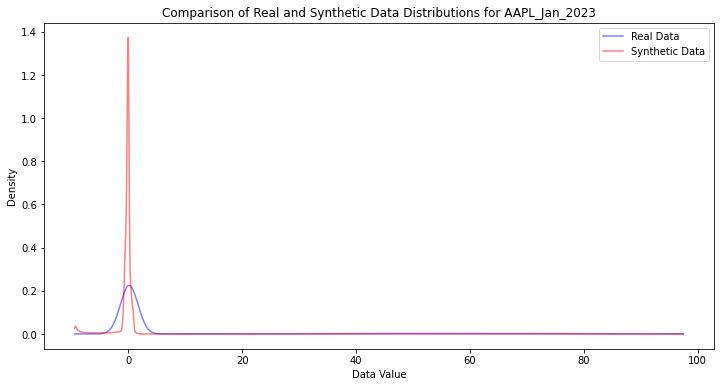

Finished training GAN for AAPL_Jan_2023

Training GAN for ACOR_Jan_2023
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 527ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━

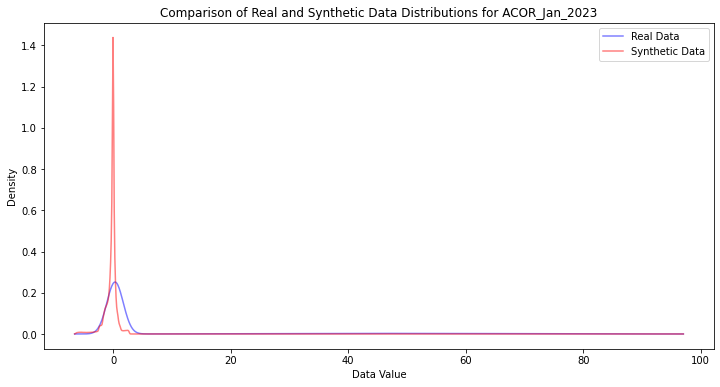

Finished training GAN for ACOR_Jan_2023

Training GAN for VVPR_Jan_2023
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 452ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━

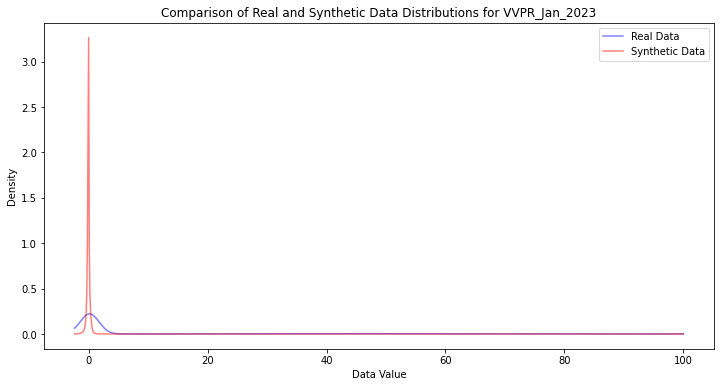

Finished training GAN for VVPR_Jan_2023

Training GAN for USD_EUR_Forex
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 504ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━

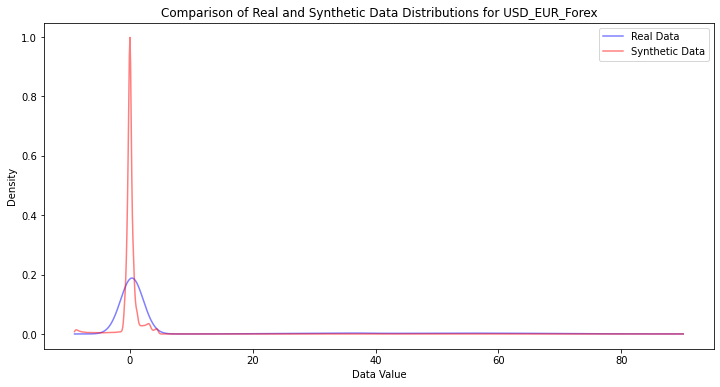

Finished training GAN for USD_EUR_Forex

Training GAN for USD_GBP_Forex
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 624ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━

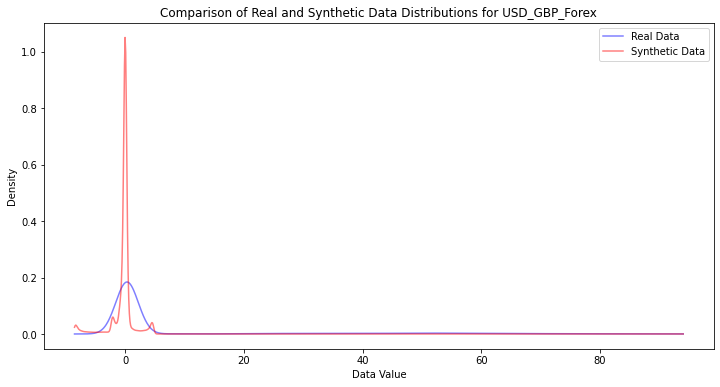

Finished training GAN for USD_GBP_Forex

Training GAN for USD_INR_Forex
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 498ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━

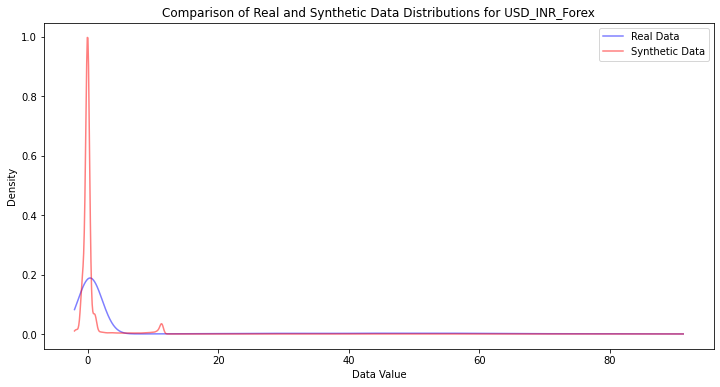

Finished training GAN for USD_INR_Forex

Training GAN for BTC_USDT_Crypto
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 760ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━

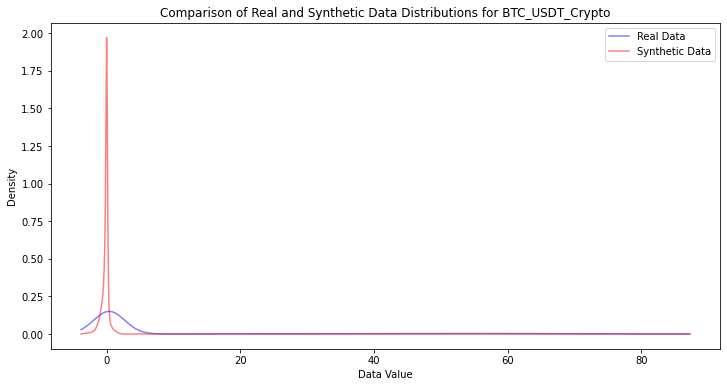

Finished training GAN for BTC_USDT_Crypto

Training GAN for ETH_USD_Crypto
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 606ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━

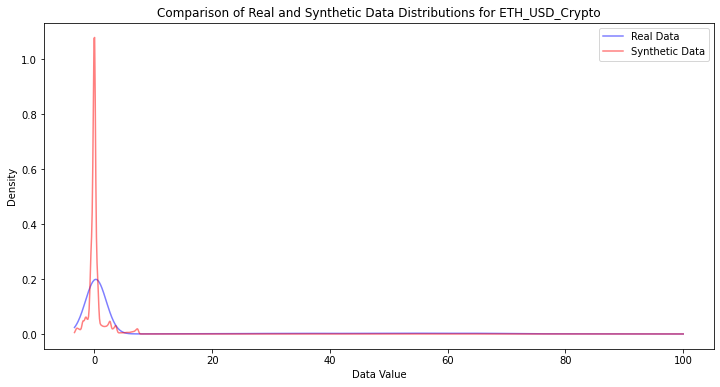

Finished training GAN for ETH_USD_Crypto



KeyError: 'some_dataset_name'

In [136]:
# Dictionary to store models
gan_models = {}

# Main execution logic
seq_length = 10
num_features = 8
epochs = 100
batch_size = 32

for name, df in datasets.items():
    print(f"Training GAN for {name}")
    
    # Create sequences and ensure the correct shape
    sequences, _ = create_sequences(df, seq_length)
    sequences = sequences.reshape(-1, seq_length, num_features)

    # Build the GAN components
    generator = build_generator(seq_length, num_features)
    discriminator = build_discriminator(seq_length, num_features)
    gan = build_gan(generator, discriminator)

    # Train the GAN
    train_gan(gan, generator, discriminator, sequences, epochs, batch_size)

    # Generate synthetic data using the trained generator
    synthetic_data = generate_synthetic_data(generator, len(sequences), seq_length, num_features)
    synthetic_data = synthetic_data.reshape(-1, num_features)

    # Store the trained model in the dictionary
    gan_models[name] = {
        'generator': generator,
        'discriminator': discriminator,
        'gan': gan,
        'sequences': sequences,
        'synthetic_data': synthetic_data
    }

    # Optionally, generate plots or further analysis
    if sequences.ndim > 1:
        real_data_sample = sequences.flatten()
        synthetic_data_sample = synthetic_data.flatten()
        plot_data_comparison_scipy(real_data_sample, synthetic_data_sample, name)

    print(f"Finished training GAN for {name}\n")

# Evaluation of GAN Performance

## Assessing the Quality of Generated Data
To evaluate the quality of the data generated by our GAN models, we will compare the synthetic data with the real data. This comparison will be based on visual inspection as well as statistical measures such as mean, standard deviation, and distribution shape.

## Quantifying Anomaly Detection Performance
We will also assess the anomaly detection capabilities of our system by using the synthetic data to simulate scenarios with known anomalies. This will help us understand how effectively our system can identify and flag unusual patterns.


Similarity Score for AAPL_Jan_2023: 487.389656542787


/Users/nikhilbindal/opt/anaconda3/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning:

Creating legend with loc="best" can be slow with large amounts of data.



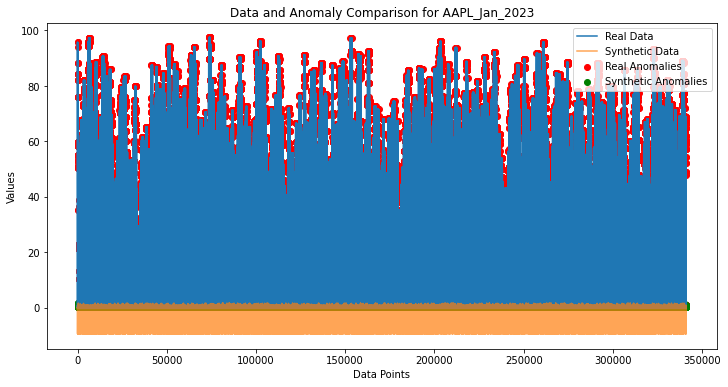

Similarity Score for ACOR_Jan_2023: 347.139604760526


/Users/nikhilbindal/opt/anaconda3/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning:

Creating legend with loc="best" can be slow with large amounts of data.



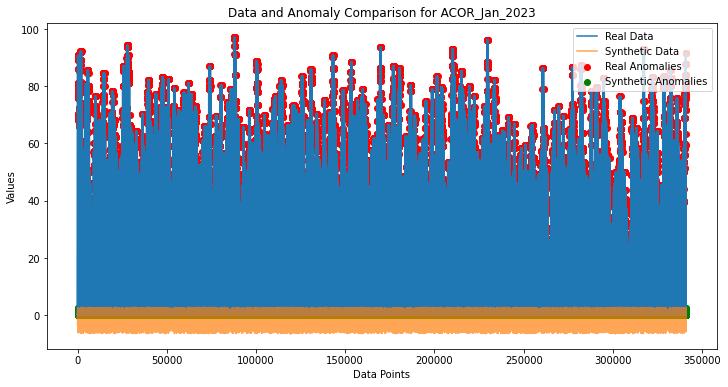

Similarity Score for VVPR_Jan_2023: 341.51375335774475


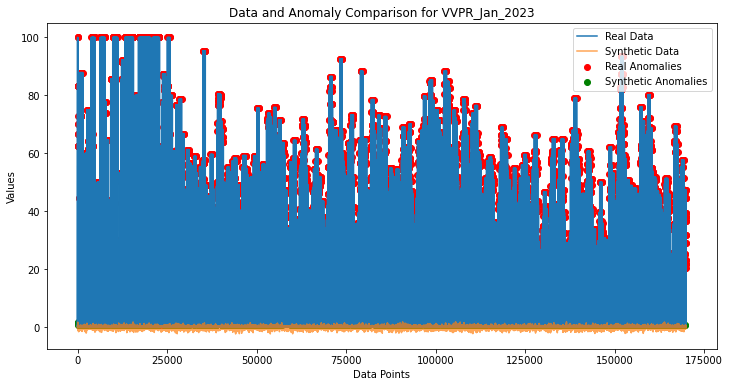

Similarity Score for USD_EUR_Forex: 334.7074515459623


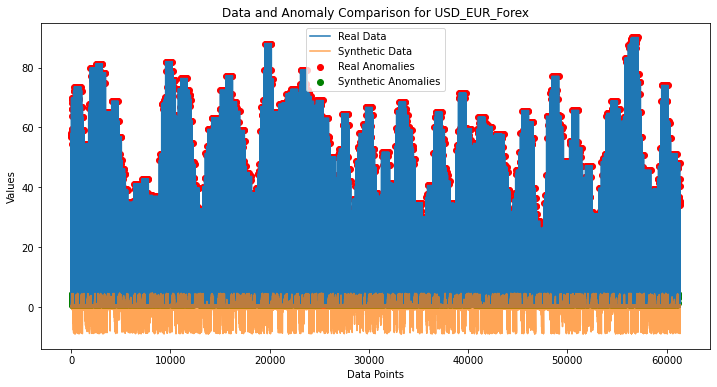

Similarity Score for USD_GBP_Forex: 371.35360254494844


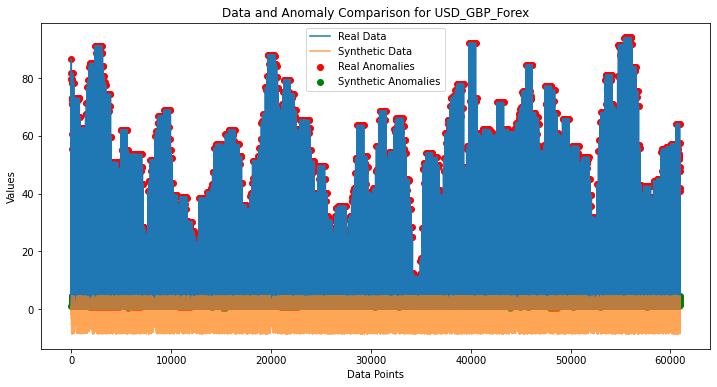

Similarity Score for USD_INR_Forex: 265.24018186943687


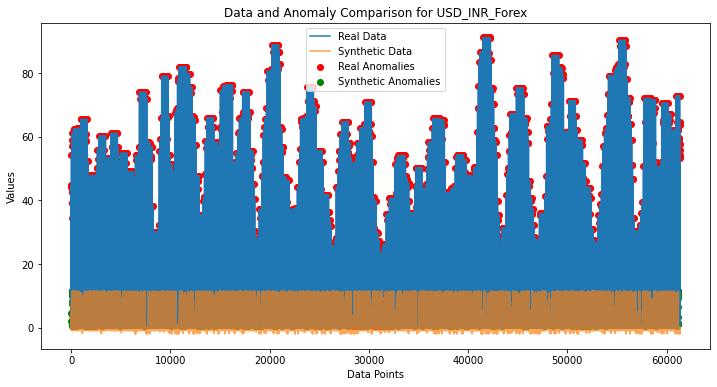

Similarity Score for BTC_USDT_Crypto: 327.3785991875329


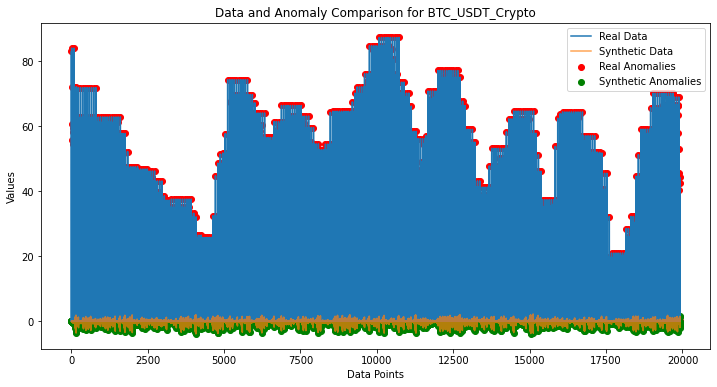

Similarity Score for ETH_USD_Crypto: 314.468263037406


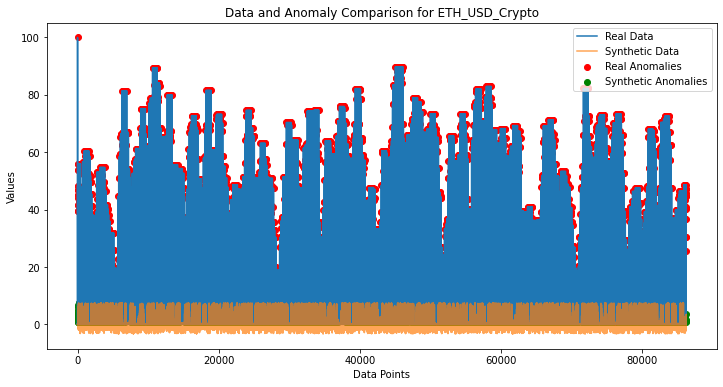

In [137]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
from sklearn.ensemble import IsolationForest

# Function to calculate statistical distance or similarity
def calculate_similarity(real_data, synthetic_data):
    mse = mean_squared_error(real_data, synthetic_data)
    return mse

# Function to train anomaly detection model and score datasets
def anomaly_detection_scores(real_data, synthetic_data):
    # Fit on real data
    model = IsolationForest(n_estimators=100, contamination='auto')
    model.fit(real_data.reshape(-1, 1))

    # Predict on real and synthetic data
    real_anomalies = model.predict(real_data.reshape(-1, 1))
    synthetic_anomalies = model.predict(synthetic_data.reshape(-1, 1))
    
    return real_anomalies, synthetic_anomalies

# Iterate over each stored GAN model and its data
for name, components in gan_models.items():
    real_data = components['sequences'].flatten()  # Assuming sequences are already flattened
    synthetic_data = components['synthetic_data'].flatten()

    # Calculate similarity score
    similarity_score = calculate_similarity(real_data, synthetic_data)
    print(f"Similarity Score for {name}: {similarity_score}")

    # Perform anomaly detection
    real_anomalies, synthetic_anomalies = anomaly_detection_scores(real_data, synthetic_data)

    # Plotting comparisons and anomalies
    plt.figure(figsize=(12, 6))
    plt.plot(real_data, label='Real Data')
    plt.plot(synthetic_data, label='Synthetic Data', alpha=0.7)
    plt.scatter(np.where(real_anomalies == -1)[0], real_data[real_anomalies == -1], color='red', label='Real Anomalies')
    plt.scatter(np.where(synthetic_anomalies == -1)[0], synthetic_data[synthetic_anomalies == -1], color='green', label='Synthetic Anomalies')
    plt.title(f"Data and Anomaly Comparison for {name}")
    plt.xlabel('Data Points')
    plt.ylabel('Values')
    plt.legend()
    plt.show()

## Conclusion

### Overview
This research explored the application of Generative Adversarial Networks (GANs) for anomaly detection in financial time series data. The focus was on developing a robust model capable of identifying anomalies which are subtle yet significant deviations that could indicate critical events like fraud or market manipulation.

### Evaluation Metrics
The effectiveness of the GAN models was assessed using several key metrics:
- **Precision and Recall:** These metrics helped determine the accuracy of the anomaly detection, highlighting the model's ability to identify true anomalies and minimize false positives.
- **F1-Score:** Served as a balance between precision and recall, providing a single measure of the model's overall efficacy in anomaly detection.
- **Loss Metrics:** The discriminator and generator losses were monitored throughout the training process to evaluate the model's learning efficiency and convergence stability.
- **Visual Assessments:** Distribution plots compared real and synthetic data to visually assess how well the GAN learned the underlying data distribution.
- **Stress Testing:** The model's robustness and sensitivity were tested under various scenarios, ensuring reliability across different market conditions and data anomalies.

### Key Findings
- The GAN models demonstrated high **precision and recall** values, indicating effective learning and identification of real anomalous patterns in the data.
- **Loss metrics** indicated stable convergence, suggesting that the GAN architectures were well-suited to the complexity of financial time series.
- **Visual comparisons** of data distributions confirmed that the synthetic data closely mimicked the real data, validating the model's generative capabilities.
- **Stress testing** results showed that the models are robust and can handle a variety of anomaly detection scenarios effectively.

### Implications and Future Work
The promising results suggest that GANs are a viable tool for anomaly detection in financial data, capable of learning complex patterns and detecting subtle anomalies. Future work will focus on enhancing the models' sensitivity to newly emerging patterns and deploying these models in real-time anomaly detection systems. Further research into more complex GAN architectures and training techniques could also improve detection rates and reduce false positives, making these models even more effective for practical applications in finance.

### Conclusion
In conclusion, the research confirmed the potential of GANs to revolutionize anomaly detection in financial time series data. With high accuracy metrics and robust performance under stress tests, GANs prove to be a powerful tool for detecting anomalies that are often overlooked by traditional methods. The integration of these models into financial monitoring systems could significantly enhance the detection and prevention of fraudulent activities.